# Multimodal RAG: Building Text + Image Retrieval Systems



In this notebook, you'll learn how to build a **Multimodal RAG (Retrieval-Augmented Generation)** system that can search through images using natural language. By the end, you'll understand:

- Why multimodal RAG matters
- How CLIP enables text-image understanding
- How to build and query a multimodal vector index
- How to construct prompts for an LLM using retrieved images

---

# Introduction: Why Multimodal RAG?

## A Quick RAG Refresher

**Retrieval-Augmented Generation (RAG)** is a pattern where we:
1. **Retrieve** relevant context from a knowledge base
2. **Augment** the prompt with that context
3. **Generate** a response using an LLM

Traditional RAG works great for text: you embed documents, store them in a vector database, and retrieve relevant passages based on a user's query.

## The Limitation of Text-Only RAG

But the real world isn't just text. Consider these scenarios:

- A user asks: *"Show me products similar to this image I took"*
- A researcher queries: *"Find satellite images showing urban flooding"*
- A customer support agent needs: *"Find screenshots of this UI bug"*

Text-only RAG simply cannot handle these. We need systems that understand **both text and images**.

## Real-World Use Cases for Multimodal RAG

| Domain | Use Case |
|--------|----------|
| **E-commerce** | Search products by image or description |
| **Medical Imaging** | Find similar X-rays, MRIs, or pathology slides |
| **Document Intelligence** | Search PDFs containing charts, diagrams, tables |
| **Content Moderation** | Find similar flagged images |
| **Creative Tools** | Search stock photos using natural language |
| **Autonomous Vehicles** | Query driving scenario databases |

**Key Insight:** Multimodal RAG enables us to search across modalities — text can find images, and images can find related content.

> **Instructor Note:** Ask the audience: "What multimodal search problems have you encountered in your work?"

---

# Conceptual Foundations: Understanding CLIP

*No code in this section — let's build intuition first.*

## What is CLIP?

**CLIP (Contrastive Language-Image Pre-training)** is a model released by OpenAI in 2021. It was trained on ~400 million text-image pairs scraped from the internet.

The magic of CLIP: it learned to understand **both text and images** in a way that lets us compare them directly.

## The Dual Encoder Architecture

CLIP has two separate encoders:

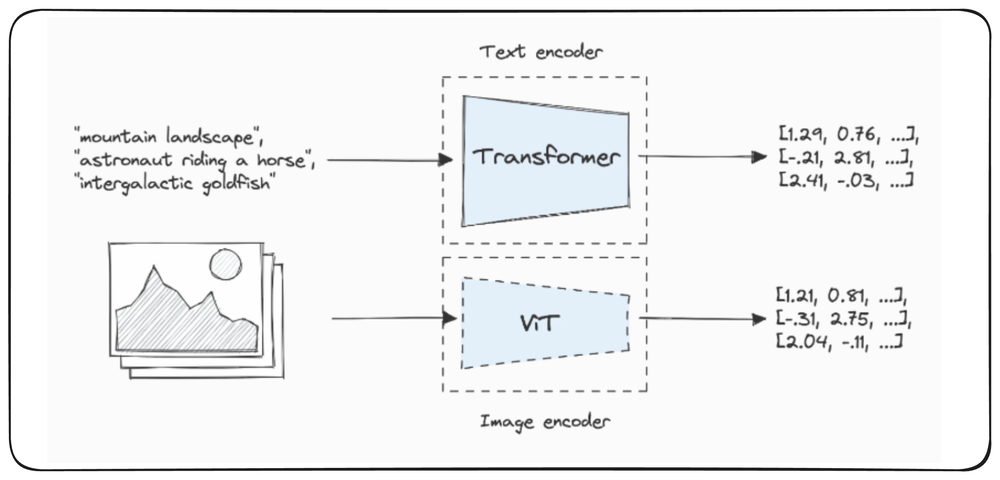

Both encoders output vectors of the **same dimension** (typically 512). This is crucial.

## The Shared Embedding Space

Here's the key insight: CLIP was trained so that **similar concepts produce similar vectors**, regardless of whether the input was text or an image.

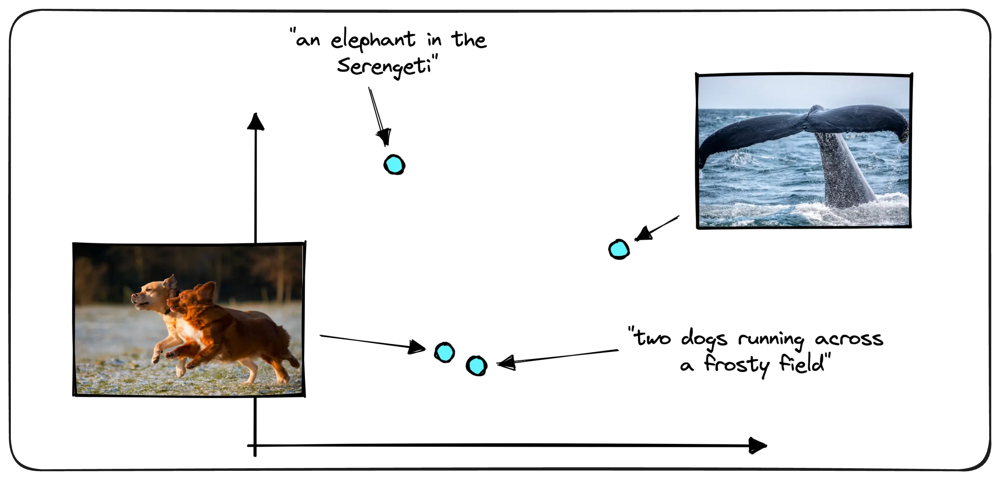

## What This Enables

Because text and images live in the **same vector space**, we can:

| Search Type | How It Works |
|------------|---------------|
| **Text → Image** | Embed text query, find nearest image embeddings |
| **Image → Image** | Embed query image, find nearest image embeddings |
| **Image → Text** | Embed image, find nearest text embeddings |


# 🔗 Understanding CLIP Pretraining — Visual Contrastive Learning Step-by-Step

**A hands-on tutorial to understand how CLIP learns aligned image-text embeddings**

---

## 📚 Overview: What is CLIP Pretraining?

**CLIP (Contrastive Language-Image Pretraining)** is a groundbreaking model that learns to understand images and text *together* by training on millions of image-caption pairs from the internet.

### The Core Idea

CLIP learns a **shared embedding space** where:
- Similar images and texts are **close together**
- Dissimilar images and texts are **far apart**

This is achieved through **contrastive learning** — a powerful technique that learns by comparing positive pairs (matching image-text) against negative pairs (non-matching).

### Why Contrastive Learning Works

Instead of predicting exact captions (hard!), CLIP asks a simpler question:
> "Given N images and N captions, which caption goes with which image?"

This turns the problem into a **matching task** that scales beautifully with data.

### The CLIP Pipeline

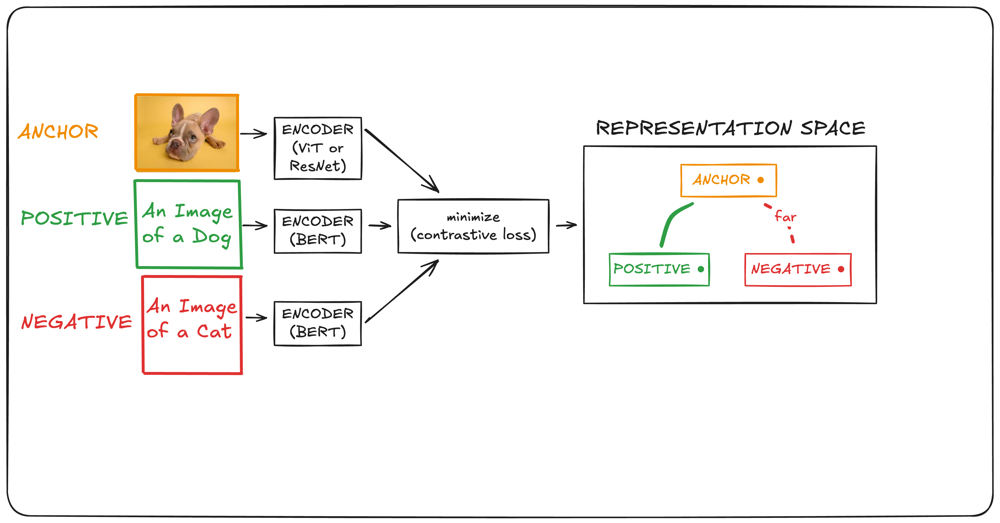

Untitled-2025-05-09-2342_loss.svg

### What You'll Learn

1. **Data**: How image-text pairs are structured
2. **Encoders**: How images and text become vectors
3. **Projection**: How we create a shared space
4. **Contrastive Loss**: The magic that aligns modalities
5. **Training**: Watching the model learn in real-time

Let's dive in! 🚀

### [Clip Dataset](https://github.com/google-research-datasets/wit)

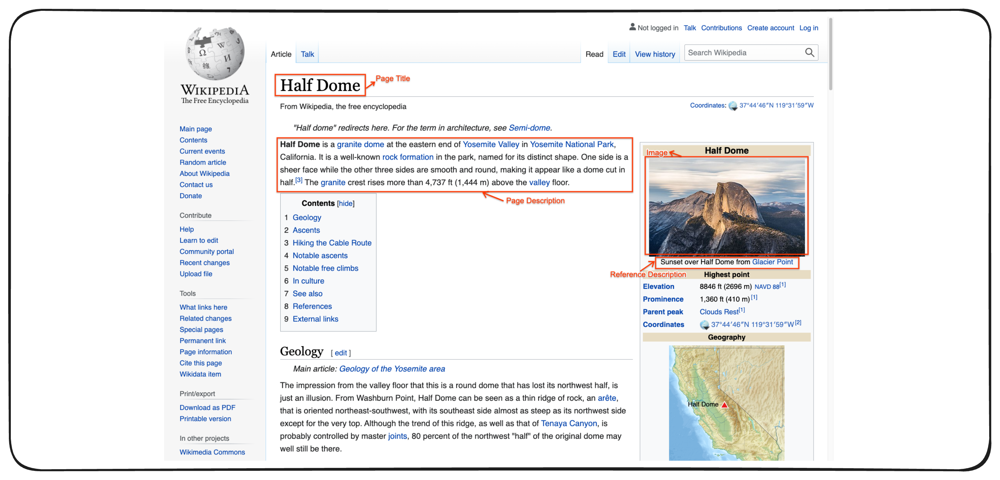

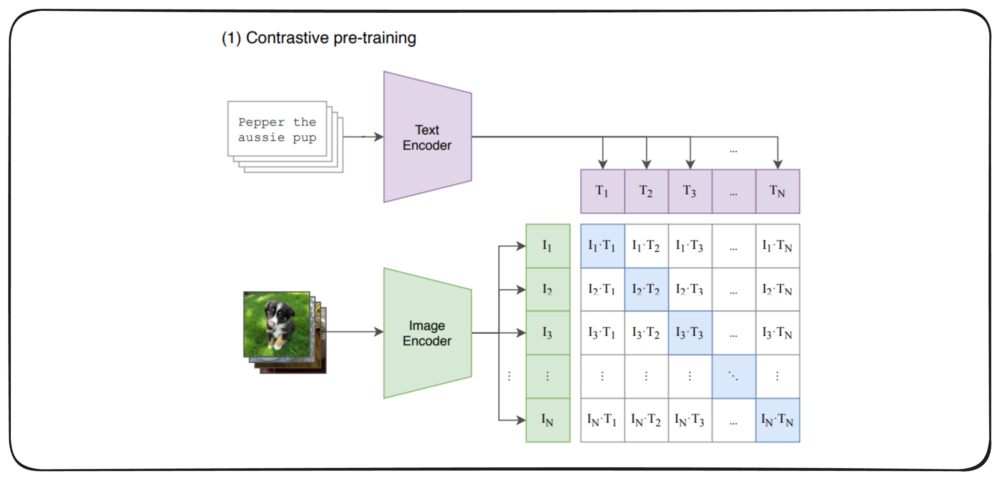

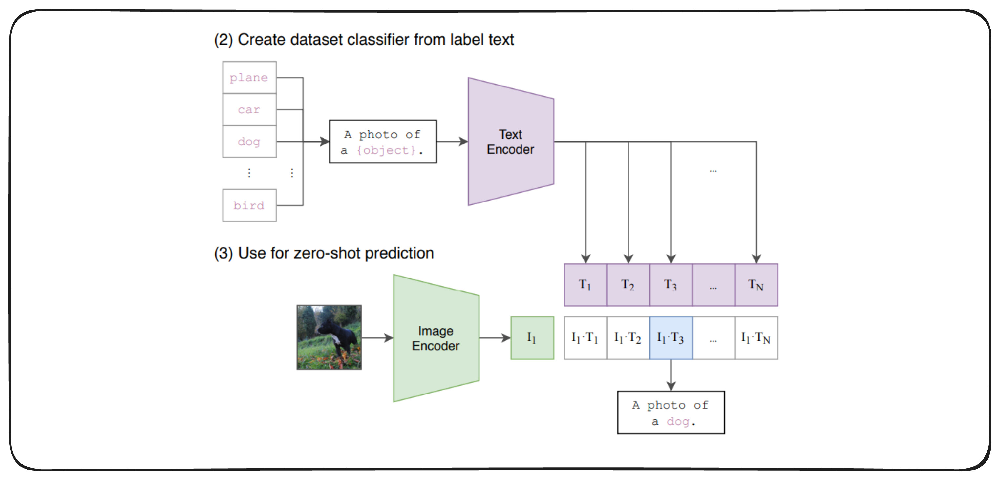



```
class CLIPModel(nn.Module):
    """
    Complete CLIP model combining:
    - Image encoder + projection
    - Text encoder + projection
    - Learnable temperature parameter
    """
    
    def __init__(self, image_encoder, text_encoder, embed_dim=128):
        super().__init__()
        
        self.image_encoder = image_encoder
        self.text_encoder = text_encoder
        
        # Projection layers to shared embedding space
        self.image_projection = nn.Linear(256, embed_dim)
        self.text_projection = nn.Linear(256, embed_dim)
        
        # Learnable temperature parameter (initialized to 0.07 as in original CLIP)
        # Higher temperature = softer probability distribution
        self.log_temperature = nn.Parameter(torch.tensor(np.log(1 / 0.07)))
        
    def encode_image(self, images):
        """Encode images to normalized embeddings."""
        features = self.image_encoder(images)
        embeddings = self.image_projection(features)
        # L2 normalize so embeddings lie on unit hypersphere
        embeddings = F.normalize(embeddings, dim=-1)
        return embeddings
    
    def encode_text(self, tokens):
        """Encode text to normalized embeddings."""
        features = self.text_encoder(tokens)
        embeddings = self.text_projection(features)
        # L2 normalize so embeddings lie on unit hypersphere
        embeddings = F.normalize(embeddings, dim=-1)
        return embeddings
    
    def forward(self, images, tokens):
        """
        Forward pass computing similarity matrix.
        
        Returns:
            logits_per_image: (N, N) similarity scores from image perspective
            logits_per_text: (N, N) similarity scores from text perspective
        """
        # Get embeddings
        image_embeds = self.encode_image(images)
        text_embeds = self.encode_text(tokens)
        
        # Compute similarity matrix (cosine similarity * temperature)
        temperature = self.log_temperature.exp()
        logits_per_image = image_embeds @ text_embeds.t() * temperature
        logits_per_text = logits_per_image.t()
        
        return logits_per_image, logits_per_text, image_embeds, text_embeds

# Create CLIP model
clip_model = CLIPModel(image_encoder, text_encoder, embed_dim=128).to(device)

```



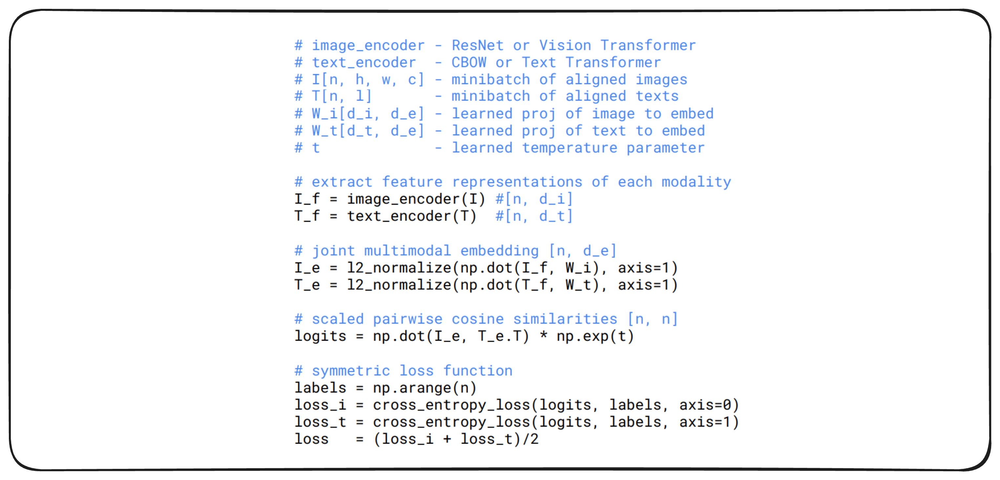



```
def clip_loss(logits_per_image, logits_per_text):
    """
    Compute the symmetric contrastive loss for CLIP.
    
    The loss encourages:
    - High similarity for matching image-text pairs (diagonal)
    - Low similarity for non-matching pairs (off-diagonal)
    
    Args:
        logits_per_image: (N, N) similarity scores, rows are images
        logits_per_text: (N, N) similarity scores, rows are texts
    
    Returns:
        Total loss (scalar)
    """
    batch_size = logits_per_image.shape[0]
    
    # Target labels: diagonal elements are the correct pairs
    # For image i, the correct text is also at index i
    labels = torch.arange(batch_size, device=logits_per_image.device)
    
    # Image-to-text loss: for each image, predict which text matches
    loss_i2t = F.cross_entropy(logits_per_image, labels)
    
    # Text-to-image loss: for each text, predict which image matches
    loss_t2i = F.cross_entropy(logits_per_text, labels)
    
    # Symmetric loss
    total_loss = (loss_i2t + loss_t2i) / 2
    
    return total_loss, loss_i2t, loss_t2i
```



### References
[CLIP Paper](https://arxiv.org/pdf/2103.00020) <br>
[Ref 1](https://www.pinecone.io/learn/series/image-search/clip/)<br>
[Ref 2](https://www.pinecone.io/learn/clip-image-search/)<br>
[Ref 3](https://huggingface.co/learn/cookbook/en/faiss_with_hf_datasets_and_clip)<br>

##  Designing our Multimodal RAG

### What You'll Learn
In this section, you'll build a **Multimodal Retrieval-Augmented Generation (RAG)** system from scratch. By the end, you'll understand:
- How to embed both text and images into a shared vector space using **CLIP**
- How to perform similarity search across modalities
- How to integrate retrieved context with **OpenAI's GPT-4o Vision** for intelligent answers

### Why GPT-4o Vision for Generation?

**GPT-4o Vision** can:
1. Process both text AND images as input
2. Reason about visual content
3. Generate coherent answers that reference retrieved images

---

## 🛠️ 2. Setup and Dependencies

First, let's install all required packages. Run this cell in Google Colab or your local environment.

In [ ]:
# ============================================================================
# CELL 1: Install Dependencies
# ============================================================================
# Run this cell first to install all required packages

# Core ML and Vision packages
!pip install -q torch torchvision  # PyTorch for deep learning
!pip install -q ftfy regex tqdm    # Text processing utilities for CLIP
!pip install -q git+https://github.com/openai/CLIP.git  # OpenAI's CLIP model

# Vector database for similarity search
!pip install -q chromadb           # ChromaDB for vector storage and retrieval

# OpenAI API for multimodal generation
!pip install -q openai             # OpenAI API client

# Visualization and utilities
!pip install -q matplotlib         # Plotting and image display
!pip install -q pillow             # Image processing
!pip install -q requests           # HTTP requests for downloading images
!pip install -q numpy              # Numerical operations

print("✅ All packages installed successfully!")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 3.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.0/52.0 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 43.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 278.2/278.2 kB 25.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 51.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.4/17.4 MB 117.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.5/72.5 kB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 132.6/132.6 kB 12.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.4/66.4 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 220.0/220.0 kB 21.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.6/71.6 kB 7.0 MB/s eta 0:00:00
   ━━━━

### Why Each Package?

| Package | Purpose |
|---------|---------|
| `torch`, `torchvision` | Deep learning framework for running CLIP |
| `clip` | OpenAI's CLIP model for multimodal embeddings |
| `chromadb` | Vector database for storing and searching embeddings |
| `openai` | API client for GPT-4o Vision |
| `matplotlib`, `pillow` | Image display and processing |
| `requests` | Downloading sample images |

---

In [ ]:
# ============================================================================
# CELL 2: Import Libraries and Verify Installation
# ============================================================================

import torch
import clip
import chromadb
from chromadb.utils.embedding_functions import OpenCLIPEmbeddingFunction
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import requests
from io import BytesIO
import base64
import os
from openai import OpenAI
from typing import List, Dict, Tuple, Union
import warnings
warnings.filterwarnings('ignore')

# Check if GPU is available
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"🖥️  Using device: {device}")

# Load CLIP model
model, preprocess = clip.load("ViT-B/32", device=device)
print(f"✅ CLIP model loaded: ViT-B/32")
print(f"📐 Embedding dimension: {model.visual.output_dim}")

🖥️  Using device: cuda


100%|████████████████████████████████████████| 338M/338M [00:01<00:00, 254MiB/s]


✅ CLIP model loaded: ViT-B/32
📐 Embedding dimension: 512


---

## 📊 3. Data Loading: Building Our Knowledge Base

We'll create a small knowledge base about famous landmarks with both text descriptions and images. This simulates a real-world scenario where you have documents with associated images.

In [ ]:
# ============================================================================
# CELL 3: Define Our Knowledge Base
# ============================================================================

# Our knowledge base: Famous landmarks with text descriptions and image URLs
KNOWLEDGE_BASE = [
    {
        "id": "eiffel_tower",
        "title": "Eiffel Tower",
        "text": """The Eiffel Tower is a wrought-iron lattice tower on the Champ de Mars
        in Paris, France. It was constructed from 1887 to 1889 as the centerpiece of
        the 1889 World's Fair. Standing at 330 meters tall, it was the tallest
        man-made structure in the world until 1930. The tower is named after the
        engineer Gustave Eiffel, whose company designed and built the structure.
        It receives about 7 million visitors annually and is painted every 7 years
        using 60 tons of paint.""",
        "image_url": "https://images.pexels.com/photos/338515/pexels-photo-338515.jpeg?w=800",
        "category": "architecture"
    },
    {
        "id": "great_wall",
        "title": "Great Wall of China",
        "text": """The Great Wall of China is a series of fortifications made of stone,
        brick, tamped earth, and other materials, built along the historical northern
        borders of China to protect against various nomadic groups. Several walls were
        built as early as the 7th century BC, with the most well-known sections built
        by the Ming Dynasty (1368-1644). The wall spans approximately 21,196 kilometers
        and is the longest structure ever built by humans. It is a UNESCO World Heritage
        Site and one of the New Seven Wonders of the World.""",
        "image_url": "https://images.unsplash.com/photo-1508804185872-d7badad00f7d?w=800",
        "category": "architecture"
    },
    {
        "id": "grand_canyon",
        "title": "Grand Canyon",
        "text": """The Grand Canyon is a steep-sided canyon carved by the Colorado River
        in Arizona, United States. It is 446 kilometers long, up to 29 kilometers wide,
        and attains a depth of over 1,800 meters. The canyon and adjacent rim are
        contained within Grand Canyon National Park. The geological formations exposed
        reveal nearly 2 billion years of Earth's history. The canyon is considered one
        of the Seven Natural Wonders of the World and attracts about 6 million visitors
        annually.""",
        "image_url": "https://images.unsplash.com/photo-1474044159687-1ee9f3a51722?w=800",
        "category": "nature"
    },
    {
        "id": "northern_lights",
        "title": "Northern Lights (Aurora Borealis)",
        "text": """The Northern Lights, or Aurora Borealis, is a natural light display
        predominantly seen in high-latitude regions around the Arctic. It is caused by
        the interaction between solar wind and Earth's magnetosphere. The lights appear
        as dynamic patterns of brilliant lights in various colors including green, pink,
        red, yellow, and blue. The best places to see the aurora include Norway, Iceland,
        Finland, Canada, and Alaska. The phenomenon occurs year-round but is only visible
        during dark nights, typically from September to March.""",
        "image_url": "https://images.unsplash.com/photo-1531366936337-7c912a4589a7?w=800",
        "category": "nature"
    },
    {
        "id": "taj_mahal",
        "title": "Taj Mahal",
        "text": """The Taj Mahal is an ivory-white marble mausoleum on the right bank
        of the river Yamuna in Agra, India. It was commissioned in 1632 by the Mughal
        emperor Shah Jahan to house the tomb of his favorite wife, Mumtaz Mahal.
        The tomb is the centerpiece of a 17-hectare complex, which includes a mosque,
        guest house, and formal gardens. Construction was completed in 1653 with the
        work of over 20,000 artisans. The Taj Mahal is regarded as the finest example
        of Mughal architecture and is a UNESCO World Heritage Site.""",
        "image_url": "https://images.unsplash.com/photo-1564507592333-c60657eea523?w=800",
        "category": "architecture"
    },
    {
        "id": "coral_reef",
        "title": "Great Barrier Reef",
        "text": """The Great Barrier Reef is the world's largest coral reef system,
        composed of over 2,900 individual reefs and 900 islands stretching over
        2,300 kilometers off the coast of Queensland, Australia. The reef supports
        a wide diversity of life including 1,500 species of fish, 400 types of coral,
        and many species of whales, dolphins, and sea turtles. It can be seen from
        space and is the world's biggest single structure made by living organisms.
        Climate change and ocean acidification pose significant threats to its survival.""",
        "image_url": "https://images.unsplash.com/photo-1682687220742-aba13b6e50ba?w=800",
        "category": "nature"
    },
    {
        "id": "machu_picchu",
        "title": "Machu Picchu",
        "text": """Machu Picchu is a 15th-century Inca citadel situated on a mountain
        ridge 2,430 meters above sea level in the Cusco Region of Peru. Built during
        the reign of Inca emperor Pachacuti (1438-1472), it was abandoned after the
        Spanish Conquest and remained unknown to the outside world until American
        historian Hiram Bingham brought international attention to it in 1911.
        The site features sophisticated dry-stone walls, terraces, and ramps.
        It is a UNESCO World Heritage Site and one of the New Seven Wonders of the World.""",
        "image_url": "https://images.unsplash.com/photo-1587595431973-160d0d94add1?w=800",
        "category": "architecture"
    },
    {
        "id": "mount_fuji",
        "title": "Mount Fuji",
        "text": """Mount Fuji is the tallest mountain in Japan, standing at 3,776 meters.
        It is an active stratovolcano that last erupted in 1707. Located on Honshu Island,
        Mount Fuji is about 100 kilometers southwest of Tokyo. The mountain is a sacred
        site and has been a popular subject of Japanese art, most famously in Hokusai's
        woodblock print series 'Thirty-six Views of Mount Fuji'. About 300,000 people
        climb Mount Fuji every year, mostly during the official climbing season from
        July to early September. It became a UNESCO World Heritage Site in 2013.""",
        "image_url": "https://images.unsplash.com/photo-1490806843957-31f4c9a91c65?w=800",
        "category": "nature"
    }
]

print(f"📚 Knowledge base loaded with {len(KNOWLEDGE_BASE)} items")
print("\n📋 Items in knowledge base:")
for item in KNOWLEDGE_BASE:
    print(f"   • {item['title']} ({item['category']})")

📚 Knowledge base loaded with 8 items

📋 Items in knowledge base:
   • Eiffel Tower (architecture)
   • Great Wall of China (architecture)
   • Grand Canyon (nature)
   • Northern Lights (Aurora Borealis) (nature)
   • Taj Mahal (architecture)
   • Great Barrier Reef (nature)
   • Machu Picchu (architecture)
   • Mount Fuji (nature)


📥 Downloading images from knowledge base...
   Downloading: Eiffel Tower... ✓
   Downloading: Great Wall of China... ✓
   Downloading: Grand Canyon... ✓
   Downloading: Northern Lights (Aurora Borealis)... ✓
   Downloading: Taj Mahal... ✓
   Downloading: Great Barrier Reef... ✓
   Downloading: Machu Picchu... ✓
   Downloading: Mount Fuji... ✓

🖼️ Displaying knowledge base images:


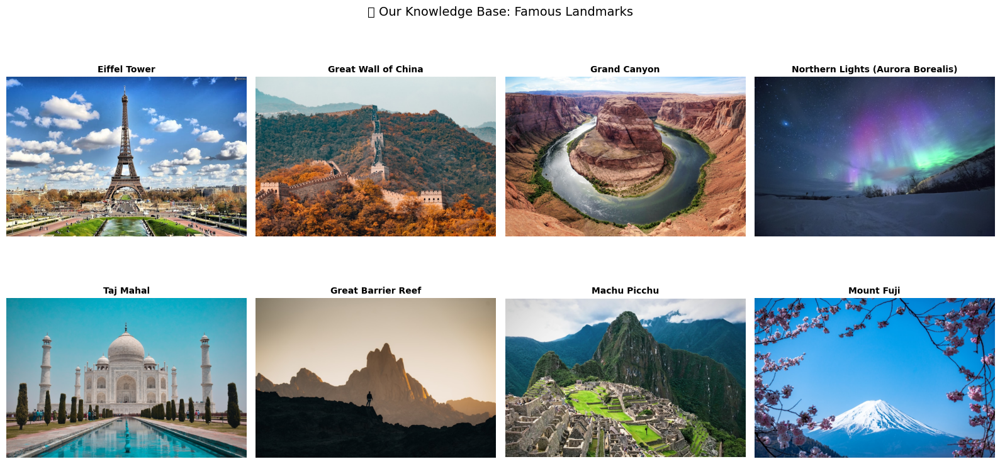

In [ ]:
# ============================================================================
# CELL 4: Download and Display Sample Images
# ============================================================================

def download_image(url: str, timeout: int = 10) -> Image.Image:
    """Download an image from URL and return as PIL Image."""
    try:
        headers = {'User-Agent': 'Mozilla/5.0 (Educational Bot)'}
        response = requests.get(url, headers=headers, timeout=timeout)
        response.raise_for_status()
        return Image.open(BytesIO(response.content)).convert("RGB")
    except Exception as e:
        print(f"⚠️  Error downloading image: {e}")
        # Return a placeholder image
        return Image.new('RGB', (400, 300), color='gray')

def display_knowledge_base(kb: List[Dict], images_per_row: int = 4):
    """Display all images in the knowledge base in a grid."""
    n_items = len(kb)
    n_rows = (n_items + images_per_row - 1) // images_per_row

    fig, axes = plt.subplots(n_rows, images_per_row, figsize=(16, 4 * n_rows))
    axes = axes.flatten() if n_rows > 1 else [axes] if n_items == 1 else axes

    for idx, item in enumerate(kb):
        img = download_image(item['image_url'])
        axes[idx].imshow(img)
        axes[idx].set_title(item['title'], fontsize=10, fontweight='bold')
        axes[idx].axis('off')

    # Hide empty subplots
    for idx in range(n_items, len(axes)):
        axes[idx].axis('off')

    plt.tight_layout()
    plt.suptitle("🖼️ Our Knowledge Base: Famous Landmarks", fontsize=14, y=1.02)
    plt.show()

# Download and store images
print("📥 Downloading images from knowledge base...")
images_dict = {}
for item in KNOWLEDGE_BASE:
    print(f"   Downloading: {item['title']}...", end=" ")
    images_dict[item['id']] = download_image(item['image_url'])
    print("✓")

print("\n🖼️ Displaying knowledge base images:")
display_knowledge_base(KNOWLEDGE_BASE)

## 🧠 4. CLIP Embedding and Vector Store

Now we'll compute CLIP embeddings for both text and images, then store them in ChromaDB for efficient similarity search.

### Understanding CLIP Embeddings

CLIP maps both text and images into a 512-dimensional vector space where semantically similar items are close together:

```
"A photo of the Eiffel Tower" → [0.12, -0.34, 0.56, ...] (512 dims)
[Image of Eiffel Tower]       → [0.11, -0.33, 0.57, ...] (512 dims)
                                 ↑ Similar vectors!
```

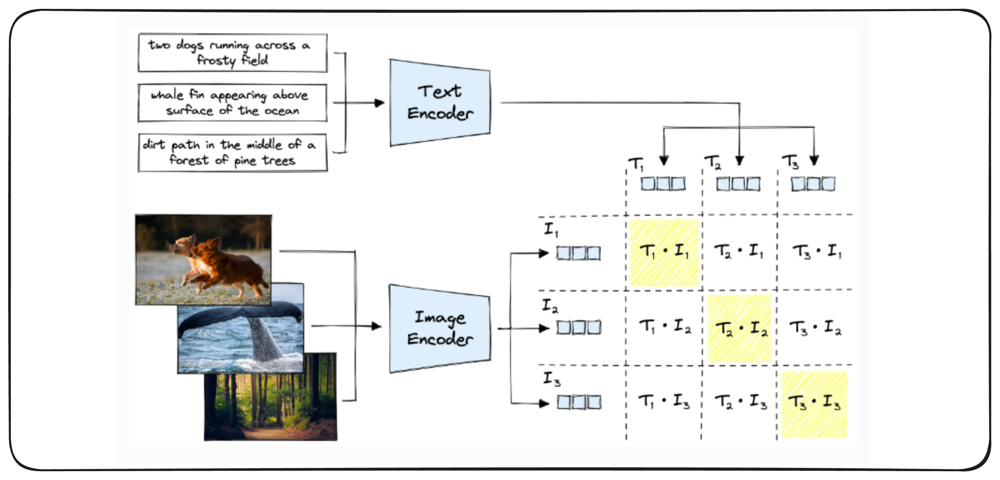

In [ ]:
# ============================================================================
# CELL 5: CLIP Embedding Functions
# ============================================================================

class CLIPEmbedder:
    """
    A class to compute CLIP embeddings for text and images.

    CLIP (Contrastive Language-Image Pretraining) embeds both modalities
    into the same vector space, enabling cross-modal similarity search.
    """

    def __init__(self, model, preprocess, device):
        self.model = model
        self.preprocess = preprocess
        self.device = device

    def embed_text(self, texts: Union[str, List[str]]) -> np.ndarray:
        """
        Compute CLIP embeddings for text.

        Args:
            texts: A single string or list of strings

        Returns:
            numpy array of shape (n_texts, 512)
        """
        if isinstance(texts, str):
            texts = [texts]

        # Tokenize text
        text_tokens = clip.tokenize(texts, truncate=True).to(self.device)

        # Compute embeddings
        with torch.no_grad():
            text_features = self.model.encode_text(text_tokens)
            # Normalize embeddings (important for cosine similarity)
            text_features = text_features / text_features.norm(dim=-1, keepdim=True)

        return text_features.cpu().numpy()

    def embed_image(self, images: Union[Image.Image, List[Image.Image]]) -> np.ndarray:
        """
        Compute CLIP embeddings for images.

        Args:
            images: A single PIL Image or list of PIL Images

        Returns:
            numpy array of shape (n_images, 512)
        """
        if isinstance(images, Image.Image):
            images = [images]

        # Preprocess images
        image_tensors = torch.stack([
            self.preprocess(img) for img in images
        ]).to(self.device)

        # Compute embeddings
        with torch.no_grad():
            image_features = self.model.encode_image(image_tensors)
            # Normalize embeddings
            image_features = image_features / image_features.norm(dim=-1, keepdim=True)

        return image_features.cpu().numpy()

    def compute_similarity(self, query_emb: np.ndarray, corpus_emb: np.ndarray) -> np.ndarray:
        """
        Compute cosine similarity between query and corpus embeddings.

        Since embeddings are normalized, dot product equals cosine similarity.
        """
        return np.dot(query_emb, corpus_emb.T)


# Initialize our embedder
embedder = CLIPEmbedder(model, preprocess, device)
print("✅ CLIPEmbedder initialized")

# Test embedding
test_text = "A beautiful sunset over the mountains"
test_embedding = embedder.embed_text(test_text)
print(f"\n📝 Test text: '{test_text}'")
print(f"📐 Embedding shape: {test_embedding.shape}")
print(f"🔢 First 5 values: {test_embedding[0, :5]}")

✅ CLIPEmbedder initialized

📝 Test text: 'A beautiful sunset over the mountains'
📐 Embedding shape: (1, 512)
🔢 First 5 values: [-0.01282  0.00744  0.0141   0.00844  0.01749]


In [ ]:
# ============================================================================
# CELL 6: Compute Embeddings for Knowledge Base
# ============================================================================

print("🔄 Computing CLIP embeddings for knowledge base...")
print("=" * 60)

# Store embeddings
text_embeddings = []
image_embeddings = []
metadata_list = []

for item in KNOWLEDGE_BASE:
    print(f"\n📍 Processing: {item['title']}")

    # Compute text embedding
    text_emb = embedder.embed_text(item['text'])
    text_embeddings.append(text_emb[0])
    print(f"   ✓ Text embedding: {text_emb.shape}")

    # Compute image embedding
    img = images_dict[item['id']]
    img_emb = embedder.embed_image(img)
    image_embeddings.append(img_emb[0])
    print(f"   ✓ Image embedding: {img_emb.shape}")

    # Store metadata
    metadata_list.append({
        'id': item['id'],
        'title': item['title'],
        'text': item['text'],
        'category': item['category']
    })

# Convert to numpy arrays
text_embeddings = np.array(text_embeddings)
image_embeddings = np.array(image_embeddings)

print("\n" + "=" * 60)
print(f"📊 Summary:")
print(f"   • Text embeddings shape: {text_embeddings.shape}")
print(f"   • Image embeddings shape: {image_embeddings.shape}")
print(f"   • Total items: {len(metadata_list)}")

🔄 Computing CLIP embeddings for knowledge base...

📍 Processing: Eiffel Tower
   ✓ Text embedding: (1, 512)
   ✓ Image embedding: (1, 512)

📍 Processing: Great Wall of China
   ✓ Text embedding: (1, 512)
   ✓ Image embedding: (1, 512)

📍 Processing: Grand Canyon
   ✓ Text embedding: (1, 512)
   ✓ Image embedding: (1, 512)

📍 Processing: Northern Lights (Aurora Borealis)
   ✓ Text embedding: (1, 512)
   ✓ Image embedding: (1, 512)

📍 Processing: Taj Mahal
   ✓ Text embedding: (1, 512)
   ✓ Image embedding: (1, 512)

📍 Processing: Great Barrier Reef
   ✓ Text embedding: (1, 512)
   ✓ Image embedding: (1, 512)

📍 Processing: Machu Picchu
   ✓ Text embedding: (1, 512)
   ✓ Image embedding: (1, 512)

📍 Processing: Mount Fuji
   ✓ Text embedding: (1, 512)
   ✓ Image embedding: (1, 512)

📊 Summary:
   • Text embeddings shape: (8, 512)
   • Image embeddings shape: (8, 512)
   • Total items: 8


🔥 Text-Image Similarity Matrix
(Diagonal values should be high - text matches its own image)



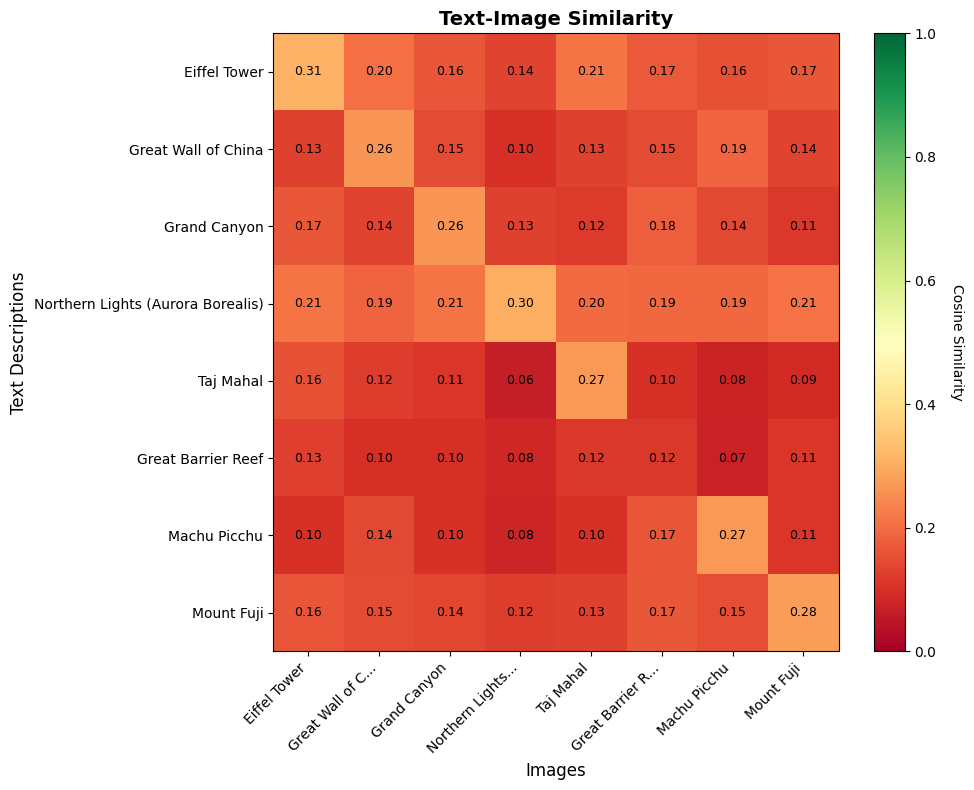


📊 Diagonal Analysis (text-image alignment):
   ✅ Eiffel Tower: 0.312
   ✅ Great Wall of China: 0.263
   ✅ Grand Canyon: 0.264
   ✅ Northern Lights (Aurora Borealis): 0.302
   ✅ Taj Mahal: 0.267
   ⚠️ Great Barrier Reef: 0.116
   ✅ Machu Picchu: 0.266
   ✅ Mount Fuji: 0.277

   Mean diagonal similarity: 0.258


In [ ]:
# ============================================================================
# CELL 7: Visualize Text-Image Similarity Matrix
# ============================================================================

def plot_similarity_matrix(text_embs: np.ndarray, image_embs: np.ndarray,
                           labels: List[str], title: str = "Text-Image Similarity"):
    """
    Plot a heatmap showing similarity between text and image embeddings.

    This visualization helps understand how well CLIP aligns text descriptions
    with their corresponding images.
    """
    # Compute similarity matrix
    similarity = np.dot(text_embs, image_embs.T)

    # Plot
    fig, ax = plt.subplots(figsize=(10, 8))
    im = ax.imshow(similarity, cmap='RdYlGn', aspect='auto', vmin=0, vmax=1)

    # Labels
    ax.set_xticks(range(len(labels)))
    ax.set_yticks(range(len(labels)))
    ax.set_xticklabels([l[:15] + '...' if len(l) > 15 else l for l in labels],
                       rotation=45, ha='right')
    ax.set_yticklabels(labels)

    # Add text annotations
    for i in range(len(labels)):
        for j in range(len(labels)):
            text = ax.text(j, i, f'{similarity[i, j]:.2f}',
                          ha='center', va='center', color='black', fontsize=9)

    ax.set_xlabel('Images', fontsize=12)
    ax.set_ylabel('Text Descriptions', fontsize=12)
    ax.set_title(title, fontsize=14, fontweight='bold')

    # Colorbar
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('Cosine Similarity', rotation=270, labelpad=20)

    plt.tight_layout()
    plt.show()

    # Print diagonal analysis
    print("\n📊 Diagonal Analysis (text-image alignment):")
    diagonal = np.diag(similarity)
    for i, label in enumerate(labels):
        emoji = "✅" if diagonal[i] > 0.25 else "⚠️"
        print(f"   {emoji} {label}: {diagonal[i]:.3f}")
    print(f"\n   Mean diagonal similarity: {diagonal.mean():.3f}")

# Get labels
labels = [item['title'] for item in KNOWLEDGE_BASE]

# Plot similarity matrix
print("🔥 Text-Image Similarity Matrix")
print("(Diagonal values should be high - text matches its own image)\n")
plot_similarity_matrix(text_embeddings, image_embeddings, labels)

In [ ]:
# ============================================================================
# CELL 8: Initialize ChromaDB Vector Store
# ============================================================================

# Initialize ChromaDB client (in-memory for this tutorial)
chroma_client = chromadb.Client()

# Create collections for text and images
# We'll use separate collections but you could also use a unified collection

# Create text collection
text_collection = chroma_client.create_collection(
    name="landmark_texts",
    metadata={"hnsw:space": "cosine"}  # Use cosine similarity
)

# Create image collection
image_collection = chroma_client.create_collection(
    name="landmark_images",
    metadata={"hnsw:space": "cosine"}
)

# Add text embeddings to collection
text_collection.add(
    ids=[f"text_{item['id']}" for item in KNOWLEDGE_BASE],
    embeddings=text_embeddings.tolist(),
    metadatas=metadata_list,
    documents=[item['text'] for item in KNOWLEDGE_BASE]
)

# Add image embeddings to collection
image_collection.add(
    ids=[f"image_{item['id']}" for item in KNOWLEDGE_BASE],
    embeddings=image_embeddings.tolist(),
    metadatas=metadata_list
)

print("✅ ChromaDB collections created!")
print(f"   📝 Text collection: {text_collection.count()} documents")
print(f"   🖼️  Image collection: {image_collection.count()} documents")

✅ ChromaDB collections created!
   📝 Text collection: 8 documents
   🖼️  Image collection: 8 documents


In [ ]:
# ============================================================================
# CELL 9: Build the Multimodal Search Engine
# ============================================================================

class MultimodalSearchEngine:
    """
    A search engine that can handle text queries, image queries, or both.
    Uses CLIP embeddings and ChromaDB for efficient similarity search.
    """

    def __init__(self, embedder: CLIPEmbedder, text_collection, image_collection,
                 images_dict: Dict[str, Image.Image], knowledge_base: List[Dict]):
        self.embedder = embedder
        self.text_collection = text_collection
        self.image_collection = image_collection
        self.images_dict = images_dict
        self.knowledge_base = {item['id']: item for item in knowledge_base}

    def search(self, query: Union[str, Image.Image], top_k: int = 3,
               search_type: str = "both") -> Dict:
        """
        Perform multimodal search.

        Args:
            query: Text string or PIL Image
            top_k: Number of results to return
            search_type: "text", "image", or "both"

        Returns:
            Dictionary with search results and metadata
        """
        # Compute query embedding
        if isinstance(query, str):
            query_embedding = self.embedder.embed_text(query)[0]
            query_type = "text"
        else:
            query_embedding = self.embedder.embed_image(query)[0]
            query_type = "image"

        results = {"query_type": query_type, "text_results": [], "image_results": []}

        # Search text collection
        if search_type in ["text", "both"]:
            text_results = self.text_collection.query(
                query_embeddings=[query_embedding.tolist()],
                n_results=top_k,
                include=["documents", "metadatas", "distances"]
            )

            for i in range(len(text_results['ids'][0])):
                item_id = text_results['metadatas'][0][i]['id']
                results["text_results"].append({
                    "id": item_id,
                    "title": text_results['metadatas'][0][i]['title'],
                    "text": text_results['documents'][0][i],
                    "similarity": 1 - text_results['distances'][0][i],  # Convert distance to similarity
                    "category": text_results['metadatas'][0][i]['category']
                })

        # Search image collection
        if search_type in ["image", "both"]:
            image_results = self.image_collection.query(
                query_embeddings=[query_embedding.tolist()],
                n_results=top_k,
                include=["metadatas", "distances"]
            )

            for i in range(len(image_results['ids'][0])):
                item_id = image_results['metadatas'][0][i]['id']
                results["image_results"].append({
                    "id": item_id,
                    "title": image_results['metadatas'][0][i]['title'],
                    "image": self.images_dict[item_id],
                    "similarity": 1 - image_results['distances'][0][i],
                    "category": image_results['metadatas'][0][i]['category']
                })

        return results

    def display_results(self, results: Dict, query: Union[str, Image.Image]):
        """Display search results with images inline."""

        # Display query
        print("=" * 70)
        print("🔍 SEARCH QUERY")
        print("=" * 70)

        if results["query_type"] == "text":
            print(f"Query (text): \"{query}\"")
        else:
            print("Query (image):")
            plt.figure(figsize=(4, 4))
            plt.imshow(query)
            plt.axis('off')
            plt.title("Query Image", fontweight='bold')
            plt.show()

        # Display text results
        if results["text_results"]:
            print("\n" + "=" * 70)
            print("📝 TEXT RESULTS")
            print("=" * 70)
            for i, res in enumerate(results["text_results"], 1):
                print(f"\n#{i} | {res['title']} | Similarity: {res['similarity']:.4f}")
                print(f"    Category: {res['category']}")
                print(f"    Text: {res['text'][:200]}...")

        # Display image results
        if results["image_results"]:
            print("\n" + "=" * 70)
            print("🖼️  IMAGE RESULTS")
            print("=" * 70)

            n_results = len(results["image_results"])
            fig, axes = plt.subplots(1, n_results, figsize=(5 * n_results, 5))
            if n_results == 1:
                axes = [axes]

            for i, res in enumerate(results["image_results"]):
                axes[i].imshow(res['image'])
                axes[i].set_title(f"#{i+1}: {res['title']}\nSimilarity: {res['similarity']:.4f}",
                                 fontweight='bold')
                axes[i].axis('off')

            plt.tight_layout()
            plt.show()

# Initialize search engine
search_engine = MultimodalSearchEngine(
    embedder=embedder,
    text_collection=text_collection,
    image_collection=image_collection,
    images_dict=images_dict,
    knowledge_base=KNOWLEDGE_BASE
)

print("✅ MultimodalSearchEngine initialized!")

✅ MultimodalSearchEngine initialized!


🔍 SEARCH QUERY
Query (text): "beautiful natural formations carved by water"

📝 TEXT RESULTS

#1 | Northern Lights (Aurora Borealis) | Similarity: 0.6004
    Category: nature
    Text: The Northern Lights, or Aurora Borealis, is a natural light display 
        predominantly seen in high-latitude regions around the Arctic. It is caused by 
        the interaction between solar wind ...

#2 | Great Wall of China | Similarity: 0.5314
    Category: architecture
    Text: The Great Wall of China is a series of fortifications made of stone, 
        brick, tamped earth, and other materials, built along the historical northern 
        borders of China to protect against...

#3 | Grand Canyon | Similarity: 0.5216
    Category: nature
    Text: The Grand Canyon is a steep-sided canyon carved by the Colorado River 
        in Arizona, United States. It is 446 kilometers long, up to 29 kilometers wide, 
        and attains a depth of over 1,80...

🖼️  IMAGE RESULTS


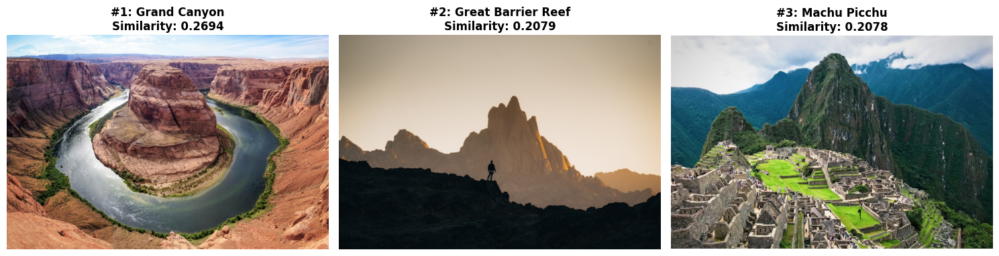

In [ ]:
# ============================================================================
# CELL 10: Test Search with Text Query
# ============================================================================

# Example 1: Search for natural wonders
query = "beautiful natural formations carved by water"
results = search_engine.search(query, top_k=3)
search_engine.display_results(results, query)


🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 

🔍 SEARCH QUERY
Query (text): "ancient Asian architecture temple"

📝 TEXT RESULTS

#1 | Great Wall of China | Similarity: 0.6904
    Category: architecture
    Text: The Great Wall of China is a series of fortifications made of stone, 
        brick, tamped earth, and other materials, built along the historical northern 
        borders of China to protect against...

#2 | Eiffel Tower | Similarity: 0.6230
    Category: architecture
    Text: The Eiffel Tower is a wrought-iron lattice tower on the Champ de Mars 
        in Paris, France. It was constructed from 1887 to 1889 as the centerpiece of 
        the 1889 World's Fair. Standing at ...

#3 | Northern Lights (Aurora Borealis) | Similarity: 0.6107
    Category: nature
    Text: The Northern Lights, or Aurora Borealis, is a natural light display 
        predominantly seen in high-latitude regions around the Arctic. It is caused by 
        the interaction between solar wind ...

🖼️  IMAGE 

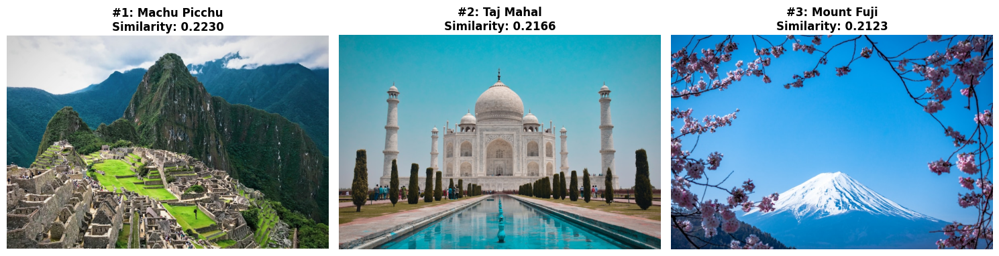

In [ ]:
# ============================================================================
# CELL 11: Test Search with Different Queries
# ============================================================================

# Example 2: Search for Asian landmarks
print("\n" + "🔍 " * 20 + "\n")
query = "ancient Asian architecture temple"
results = search_engine.search(query, top_k=3)
search_engine.display_results(results, query)


🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 

Searching with an IMAGE query (Eiffel Tower)...
🔍 SEARCH QUERY
Query (image):


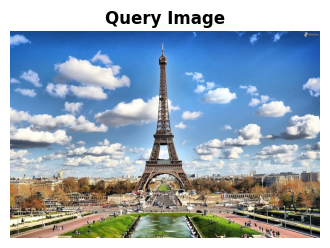


📝 TEXT RESULTS

#1 | Eiffel Tower | Similarity: 0.3114
    Category: architecture
    Text: The Eiffel Tower is a wrought-iron lattice tower on the Champ de Mars 
        in Paris, France. It was constructed from 1887 to 1889 as the centerpiece of 
        the 1889 World's Fair. Standing at ...

#2 | Northern Lights (Aurora Borealis) | Similarity: 0.2137
    Category: nature
    Text: The Northern Lights, or Aurora Borealis, is a natural light display 
        predominantly seen in high-latitude regions around the Arctic. It is caused by 
        the interaction between solar wind ...

#3 | Grand Canyon | Similarity: 0.1662
    Category: nature
    Text: The Grand Canyon is a steep-sided canyon carved by the Colorado River 
        in Arizona, United States. It is 446 kilometers long, up to 29 kilometers wide, 
        and attains a depth of over 1,80...

🖼️  IMAGE RESULTS


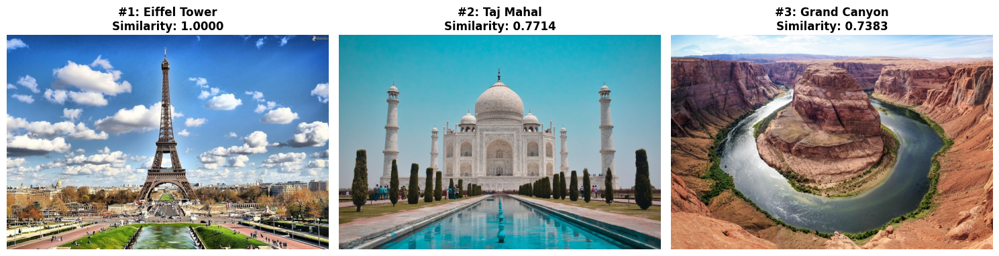

In [ ]:
# ============================================================================
# CELL 12: Test Search with Image Query
# ============================================================================

# Example 3: Search using an image as query
print("\n" + "🔍 " * 20 + "\n")
print("Searching with an IMAGE query (Eiffel Tower)...")

# Use one of our images as query
query_image = images_dict['eiffel_tower']
results = search_engine.search(query_image, top_k=3)
search_engine.display_results(results, query_image)

## 🤖 6. OpenAI Multimodal LLM Integration

Now let's integrate GPT-4o Vision to generate intelligent answers from our retrieved context.

In [ ]:
# ============================================================================
# CELL 13: Setup OpenAI Client
# ============================================================================
from getpass import getpass
# ⚠️ IMPORTANT: Set your OpenAI API key
# Option 1: Set environment variable
os.environ["OPENAI_API_KEY"] = getpass("your-api-key-here")


your-api-key-here··········


In [ ]:


# Initialize OpenAI client
try:
    client = OpenAI()
    # Test the connection
    print("✅ OpenAI client initialized successfully!")
except Exception as e:
    print(f"⚠️ OpenAI client initialization failed: {e}")
    print("Please set your OPENAI_API_KEY environment variable")

✅ OpenAI client initialized successfully!


In [ ]:
# ============================================================================
# CELL 14: Helper Functions for Multimodal Generation
# ============================================================================

def image_to_base64(image: Image.Image, max_size: int = 512) -> str:
    """
    Convert PIL Image to base64 string for OpenAI API.

    Resizes image if too large to reduce token usage.
    """
    # Resize if needed
    if max(image.size) > max_size:
        ratio = max_size / max(image.size)
        new_size = tuple(int(dim * ratio) for dim in image.size)
        image = image.resize(new_size, Image.LANCZOS)

    # Convert to base64
    buffer = BytesIO()
    image.save(buffer, format="JPEG")
    return base64.b64encode(buffer.getvalue()).decode('utf-8')


def build_multimodal_prompt(query: str, text_results: List[Dict],
                            image_results: List[Dict]) -> List[Dict]:
    """
    Build a multimodal prompt for GPT-4o Vision.

    Includes retrieved text context and images.
    """
    # Build context string
    context_text = "RETRIEVED CONTEXT:\n\n"

    for i, res in enumerate(text_results, 1):
        context_text += f"Document {i}: {res['title']}\n"
        context_text += f"{res['text']}\n\n"

    # Build message content
    content = [
        {
            "type": "text",
            "text": f"""You are a knowledgeable assistant helping answer questions about famous landmarks and natural wonders.

{context_text}

Based on the above context and the images provided below, please answer the following question:

QUESTION: {query}

Instructions:
1. Use information from both the text context AND the images to answer
2. If relevant details are visible in the images, mention them
3. Be informative but concise
4. If you're not sure about something, say so"""
        }
    ]

    # Add images
    for i, res in enumerate(image_results):
        img_base64 = image_to_base64(res['image'])
        content.append({
            "type": "text",
            "text": f"\n[Image {i+1}: {res['title']}]"
        })
        content.append({
            "type": "image_url",
            "image_url": {
                "url": f"data:image/jpeg;base64,{img_base64}",
                "detail": "low"  # Use "high" for more detail, costs more tokens
            }
        })

    return [{"role": "user", "content": content}]


def visualize_prompt_context(query: str, text_results: List[Dict],
                             image_results: List[Dict]):
    """
    Visualize what we're sending to the LLM.
    """
    print("=" * 70)
    print("📤 CONTEXT BEING SENT TO GPT-4o VISION")
    print("=" * 70)

    print(f"\n🔍 Query: \"{query}\"\n")

    print("📝 Retrieved Text Context:")
    print("-" * 40)
    for i, res in enumerate(text_results, 1):
        print(f"\n[{i}] {res['title']} (similarity: {res['similarity']:.3f})")
        print(f"    {res['text'][:150]}...")

    print("\n\n🖼️  Retrieved Images:")
    print("-" * 40)

    n_images = len(image_results)
    if n_images > 0:
        fig, axes = plt.subplots(1, n_images, figsize=(5 * n_images, 5))
        if n_images == 1:
            axes = [axes]

        for i, res in enumerate(image_results):
            axes[i].imshow(res['image'])
            axes[i].set_title(f"Image {i+1}: {res['title']}\n(sim: {res['similarity']:.3f})",
                            fontweight='bold')
            axes[i].axis('off')

        plt.tight_layout()
        plt.show()

In [ ]:
# ============================================================================
# CELL 15: Build the Multimodal RAG Pipeline
# ============================================================================

class MultimodalRAG:
    """
    Complete Multimodal RAG pipeline combining:
    1. CLIP-based retrieval
    2. GPT-4o Vision generation
    """

    def __init__(self, search_engine: MultimodalSearchEngine,
                 openai_client: OpenAI,
                 model: str = "gpt-4o"):
        self.search_engine = search_engine
        self.client = openai_client
        self.model = model

    def answer(self, query: str, top_k: int = 3,
               show_context: bool = True) -> str:
        """
        Answer a question using multimodal RAG.

        Args:
            query: The user's question
            top_k: Number of results to retrieve
            show_context: Whether to display retrieved context

        Returns:
            Generated answer from GPT-4o Vision
        """
        # Step 1: Retrieve relevant context
        print("🔍 Step 1: Retrieving relevant context...")
        results = self.search_engine.search(query, top_k=top_k, search_type="both")

        # Step 2: Visualize context (optional)
        if show_context:
            visualize_prompt_context(query, results["text_results"],
                                   results["image_results"])

        # Step 3: Build multimodal prompt
        print("\n📝 Step 2: Building multimodal prompt...")
        messages = build_multimodal_prompt(
            query,
            results["text_results"],
            results["image_results"]
        )

        # Step 4: Generate answer
        print("🤖 Step 3: Generating answer with GPT-4o Vision...\n")

        try:
            response = self.client.chat.completions.create(
                model=self.model,
                messages=messages,
                max_tokens=500,
                temperature=0.7
            )
            answer = response.choices[0].message.content
        except Exception as e:
            answer = f"Error generating response: {e}"

        # Step 5: Display answer
        print("=" * 70)
        print("💬 GENERATED ANSWER")
        print("=" * 70)
        print(f"\n{answer}\n")

        return answer

# Initialize the RAG pipeline
# Note: Uncomment when you have your API key set
# rag = MultimodalRAG(search_engine, client)
print("✅ MultimodalRAG class defined!")
print("⚠️ Initialize with: rag = MultimodalRAG(search_engine, client)")

✅ MultimodalRAG class defined!
⚠️ Initialize with: rag = MultimodalRAG(search_engine, client)


## 🎮 7. Interactive Example Queries

Let's run several examples to see our multimodal RAG system in action!

In [ ]:
# ============================================================================
# CELL 16: Initialize RAG Pipeline
# ============================================================================

# Make sure you've set your OpenAI API key before running this!
# os.environ["OPENAI_API_KEY"] = "your-key-here"

try:
    rag = MultimodalRAG(search_engine, client)
    print("✅ RAG pipeline ready!")
except Exception as e:
    print(f"⚠️ Error: {e}")
    print("Make sure you've set your OPENAI_API_KEY")

✅ RAG pipeline ready!


🔍 Step 1: Retrieving relevant context...
📤 CONTEXT BEING SENT TO GPT-4o VISION

🔍 Query: "What is the most impressive ancient structure built for defense purposes?"

📝 Retrieved Text Context:
----------------------------------------

[1] Northern Lights (Aurora Borealis) (similarity: 0.683)
    The Northern Lights, or Aurora Borealis, is a natural light display 
        predominantly seen in high-latitude regions around the Arctic. It is caus...

[2] Eiffel Tower (similarity: 0.641)
    The Eiffel Tower is a wrought-iron lattice tower on the Champ de Mars 
        in Paris, France. It was constructed from 1887 to 1889 as the centerpie...

[3] Great Wall of China (similarity: 0.638)
    The Great Wall of China is a series of fortifications made of stone, 
        brick, tamped earth, and other materials, built along the historical nor...


🖼️  Retrieved Images:
----------------------------------------


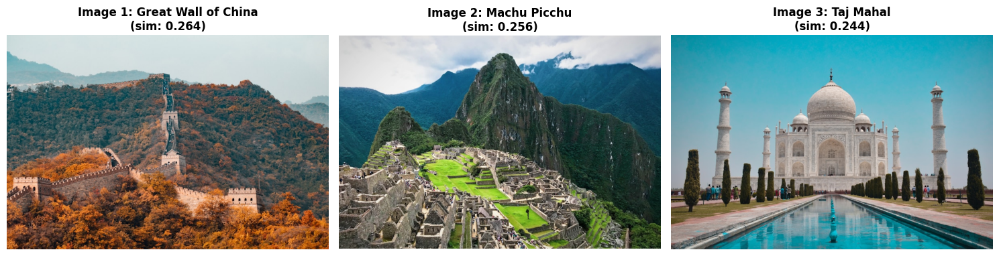


📝 Step 2: Building multimodal prompt...
🤖 Step 3: Generating answer with GPT-4o Vision...

💬 GENERATED ANSWER

The most impressive ancient structure built for defense purposes is the Great Wall of China. According to the provided context, it is a series of fortifications stretching approximately 21,196 kilometers, constructed to protect against nomadic groups. Built primarily during the Ming Dynasty, it is recognized as the longest structure ever built by humans and is a UNESCO World Heritage Site. The image clearly shows this iconic structure winding through rugged terrain, highlighting its extensive and strategic design.



In [ ]:
# ============================================================================
# CELL 17: Example Query 1 - Historical Architecture
# ============================================================================

query1 = "What is the most impressive ancient structure built for defense purposes?"
answer1 = rag.answer(query1, top_k=3)

# 📚 Multimodal RAG with Document Retrieval (ColPali) and Vision Language Models (VLMs)

**This notebook follows the [original Hugging Face Cookbook tutorial](https://huggingface.co/learn/cookbook/en/multimodal_rag_using_document_retrieval_and_vlms) exactly, with added visual outputs and explanatory comments to help learners see what's happening at each step.**

### What This Section of the notebook Demonstrates

We build a **Multimodal RAG system** combining:
- **ColPali** for document retrieval (treating PDFs as images)
- **Qwen2-VL** for visual question answering

Instead of complex OCR pipelines, we leverage vision-language models to directly understand document pages as images.

---

⚠️ **Requirements**: This notebook requires a GPU with at least 24GB VRAM (e.g., A100, L4). Tested on Colab with A100.

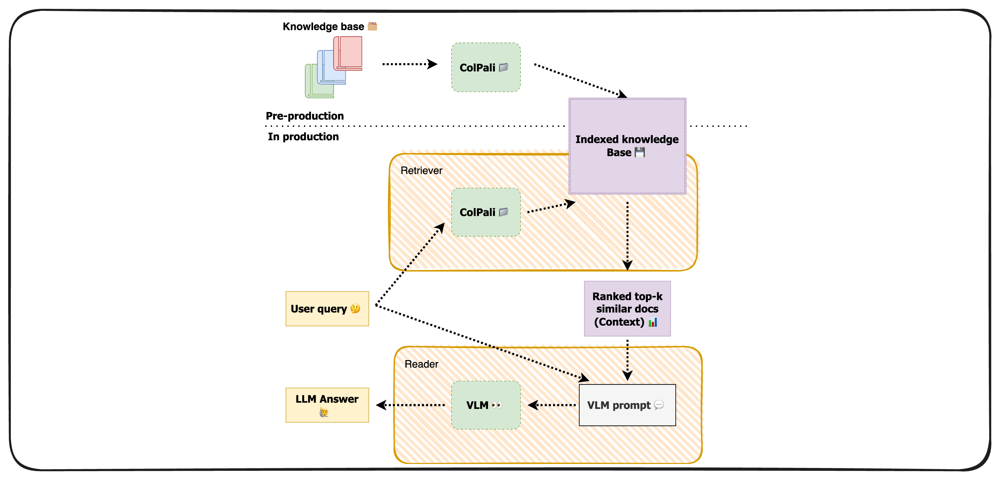

---

## 🛠️  Install Dependencies

As in the original tutorial, we install the essential libraries:
- `byaldi`: A wrapper around ColPali for easy document retrieval
- `pdf2image`: Converts PDF pages to images
- `qwen-vl-utils`: Utilities for Qwen2-VL input processing
- `transformers`: Hugging Face model loading

In [ ]:
# ============================================================================
# CELL 1: Install Dependencies (from original tutorial)
# ============================================================================

# Install required packages
# - byaldi: Wrapper for ColPali document retrieval
# - pdf2image: Convert PDF pages to PIL images for processing
# - qwen-vl-utils: Helper utilities for Qwen2-VL model
# - transformers: Load pre-trained models from Hugging Face

!pip install -U -q byaldi pdf2image qwen-vl-utils transformers

# Install poppler for PDF rendering (required by pdf2image)
!apt-get update -qq && apt-get install -y -qq poppler-utils

print("✅ All dependencies installed!")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 517.9/517.9 kB 38.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.6/88.6 kB 9.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.9/887.9 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 594.3/594.3 MB 1.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 150.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.0/88.0 MB 25.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 954.8/954.8 kB 59.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 193.1/193.1 MB 11.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 81.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.6/63.6 MB 36.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 267.5/267.5 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 288.2/288.2 MB 3.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 

In [ ]:
# ============================================================================
# CELL 2: Import Libraries
# ============================================================================

import requests
import os
import torch
import matplotlib.pyplot as plt
from PIL import Image
from pdf2image import convert_from_path
from byaldi import RAGMultiModalModel
from transformers import Qwen2VLForConditionalGeneration, Qwen2VLProcessor
from qwen_vl_utils import process_vision_info
import warnings
warnings.filterwarnings('ignore')

# Check GPU availability
print(f"🖥️  CUDA available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"🎮 GPU: {torch.cuda.get_device_name(0)}")
    print(f"💾 GPU Memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.1f} GB")

🖥️  CUDA available: True
🎮 GPU: NVIDIA A100-SXM4-40GB
💾 GPU Memory: 42.5 GB


---

## 📥 Step 2: Download IKEA Assembly Instructions (PDFs)

Following the original tutorial, we download assembly instructions for 5 IKEA products:
- **MALM** (4-drawer chest)
- **BILLY** (bookcase)
- **BOAXEL** (wall upright)
- **ADILS** (leg)
- **MICKE** (desk)

These PDFs contain diagrams, tables, and visual instructions — perfect for testing multimodal retrieval!

In [ ]:
# ============================================================================
# CELL 3: Download IKEA PDFs (from original tutorial)
# ============================================================================

# Dictionary of IKEA product assembly instructions
# These contain diagrams, tables, and visual instructions
pdfs = {
    "MALM": "https://www.ikea.com/us/en/assembly_instructions/malm-4-drawer-chest-white__AA-2398381-2-100.pdf",
    "BILLY": "https://www.ikea.com/us/en/assembly_instructions/billy-bookcase-white__AA-1844854-6-2.pdf",
    "BOAXEL": "https://www.ikea.com/us/en/assembly_instructions/boaxel-wall-upright-white__AA-2341341-2-100.pdf",
    "ADILS": "https://www.ikea.com/us/en/assembly_instructions/adils-leg-white__AA-844478-6-2.pdf",
    "MICKE": "https://www.ikea.com/us/en/assembly_instructions/micke-desk-white__AA-476626-10-100.pdf"
}

# Create data directory
output_dir = "data"
os.makedirs(output_dir, exist_ok=True)

# Download each PDF
print("📥 Downloading IKEA assembly instructions...\n")
for name, url in pdfs.items():
    try:
        response = requests.get(url, timeout=30)
        response.raise_for_status()
        pdf_path = os.path.join(output_dir, f"{name}.pdf")
        with open(pdf_path, "wb") as f:
            f.write(response.content)
        print(f"   ✅ Downloaded {name} ({len(response.content) / 1024:.1f} KB)")
    except Exception as e:
        print(f"   ❌ Failed to download {name}: {e}")

print(f"\n📁 Downloaded files: {os.listdir(output_dir)}")

📥 Downloading IKEA assembly instructions...

   ✅ Downloaded MALM (3639.9 KB)
   ✅ Downloaded BILLY (1857.3 KB)
   ✅ Downloaded BOAXEL (2090.9 KB)
   ✅ Downloaded ADILS (1100.8 KB)
   ✅ Downloaded MICKE (1940.8 KB)

📁 Downloaded files: ['BOAXEL.pdf', 'BILLY.pdf', 'ADILS.pdf', 'MICKE.pdf', 'MALM.pdf']


---

## 🖼️ Step 3: Convert PDFs to Images

**Why convert PDFs to images?**

ColPali and Qwen2-VL work with images, not raw PDF files. By converting each PDF page to an image, we can:
1. Index them with ColPali for retrieval
2. Pass them to Qwen2-VL for visual question answering

This step also lets us **visualize what we're working with**.

In [ ]:
# ============================================================================
# CELL 4: Convert PDFs to Images (from original tutorial)
# ============================================================================

def convert_pdfs_to_images(pdf_folder):
    """
    Convert all PDFs in a folder to images.

    Returns:
        all_images: List of lists, where each inner list contains
                   PIL Images for each page of a PDF
    """
    all_images = []
    pdf_files = sorted([f for f in os.listdir(pdf_folder) if f.endswith('.pdf')])

    print("🔄 Converting PDFs to images...\n")
    for pdf_file in pdf_files:
        pdf_path = os.path.join(pdf_folder, pdf_file)
        images = convert_from_path(pdf_path)
        all_images.append(images)
        print(f"   📄 {pdf_file}: {len(images)} pages")

    return all_images, pdf_files

# Convert all PDFs
all_images, pdf_files = convert_pdfs_to_images(output_dir)

# Summary
total_pages = sum(len(imgs) for imgs in all_images)
print(f"\n📊 Summary: {len(all_images)} documents, {total_pages} total pages")

🔄 Converting PDFs to images...

   📄 ADILS.pdf: 8 pages
   📄 BILLY.pdf: 16 pages
   📄 BOAXEL.pdf: 20 pages
   📄 MALM.pdf: 28 pages
   📄 MICKE.pdf: 24 pages

📊 Summary: 5 documents, 96 total pages


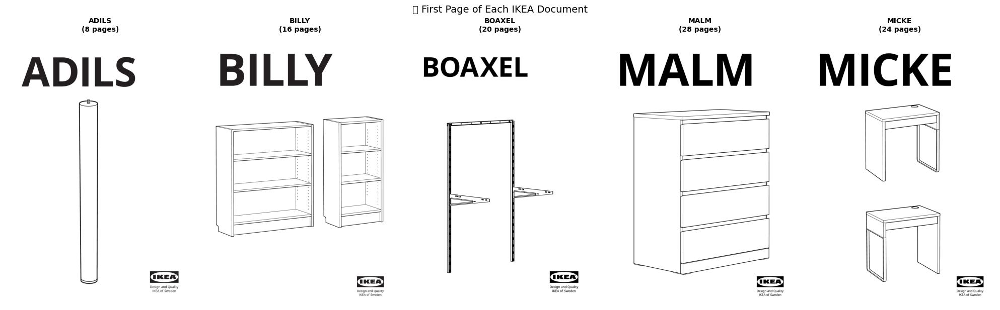


💡 Notice: These documents contain visual diagrams, numbered steps,
   and assembly instructions that traditional OCR might struggle with.


In [ ]:
# ============================================================================
# CELL 5: 🎨 VISUAL ENHANCEMENT - Display Sample Pages
# ============================================================================

def display_sample_pages(all_images, pdf_files, pages_per_doc=1):
    """
    Display the first page of each document so students can see
    what kind of content we're working with.
    """
    n_docs = len(all_images)
    fig, axes = plt.subplots(1, n_docs, figsize=(4 * n_docs, 6))

    if n_docs == 1:
        axes = [axes]

    for i, (images, pdf_name) in enumerate(zip(all_images, pdf_files)):
        axes[i].imshow(images[0])  # Show first page
        axes[i].set_title(f"{pdf_name.replace('.pdf', '')}\n({len(images)} pages)",
                         fontsize=10, fontweight='bold')
        axes[i].axis('off')

    plt.suptitle("🖼️ First Page of Each IKEA Document", fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

# Display first page of each document
display_sample_pages(all_images, pdf_files)

print("\n💡 Notice: These documents contain visual diagrams, numbered steps,")
print("   and assembly instructions that traditional OCR might struggle with.")

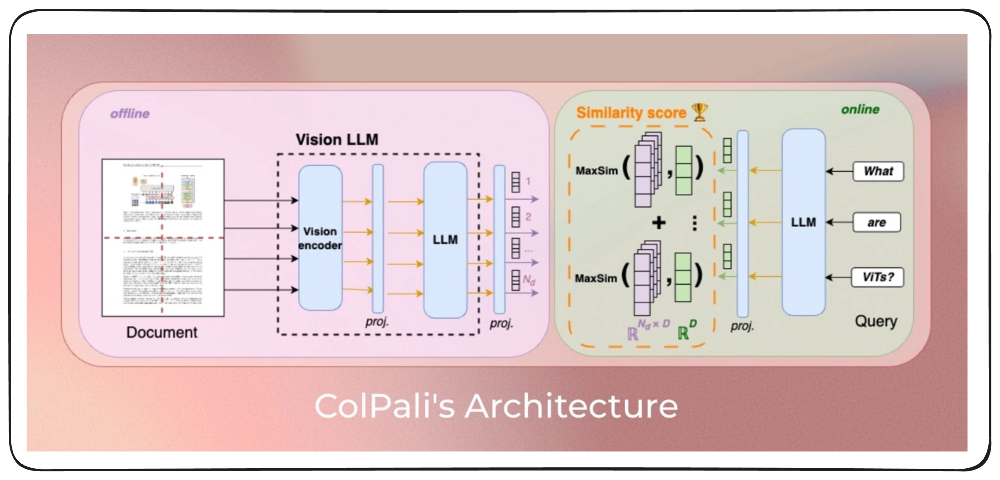

---

## 🔍 Step 4: Initialize ColPali Document Retrieval Model

**ColPali** (from the ViDoRe benchmark) uses vision-language models to:
1. Encode document pages as images
2. Enable semantic search based on visual content

We use the **byaldi** library which provides a simple API for ColPali:
```python
RAGMultiModalModel.from_pretrained("vidore/colpali-v1.2")
```

In [ ]:
# ============================================================================
# CELL 6: Load ColPali Retrieval Model (from original tutorial)
# ============================================================================

# Load ColPali model for document retrieval
# This model embeds document pages as images for semantic search
print("🔄 Loading ColPali document retrieval model...")
print("   (This may take a few minutes on first run)\n")

docs_retrieval_model = RAGMultiModalModel.from_pretrained("vidore/colpali-v1.2")

print("✅ ColPali model loaded successfully!")
print(f"   Model: vidore/colpali-v1.2")

`torch_dtype` is deprecated! Use `dtype` instead!


🔄 Loading ColPali document retrieval model...
   (This may take a few minutes on first run)

Verbosity is set to 1 (active). Pass verbose=0 to make quieter.


adapter_config.json:   0%|          | 0.00/750 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

model.safetensors.index.json: 0.00B [00:00, ?B/s]

Fetching 2 files:   0%|          | 0/2 [00:00<?, ?it/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/862M [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/4.99G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

adapter_model.safetensors:   0%|          | 0.00/78.6M [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/700 [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

tokenizer.json:   0%|          | 0.00/17.8M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/733 [00:00<?, ?B/s]

✅ ColPali model loaded successfully!
   Model: vidore/colpali-v1.2


---

## 📇 Step 5: Index Documents with ColPali

**Indexing** creates vector embeddings for each document page. This allows fast similarity search when we query later.

The `index()` method:
- Processes all PDFs in the specified folder
- Creates embeddings for each page
- Stores the index for retrieval

In [ ]:
# ============================================================================
# CELL 7: Index Documents (from original tutorial)
# ============================================================================

# Index all documents in the data folder
# This creates embeddings for each page using ColPali
print("📇 Indexing documents with ColPali...")
print("   (Processing each page as an image)\n")

docs_retrieval_model.index(
    input_path="data/",                    # Folder containing PDFs
    index_name="ikea_index",               # Name for the index
    store_collection_with_index=False,     # Don't store base64 images (saves memory)
    overwrite=True                         # Overwrite if index exists
)

print("✅ Indexing complete!")
print(f"   Indexed {len(pdf_files)} documents with {total_pages} total pages")

📇 Indexing documents with ColPali...
   (Processing each page as an image)

Indexing file: data/BOAXEL.pdf
Added page 1 of document 0 to index.
Added page 2 of document 0 to index.
Added page 3 of document 0 to index.
Added page 4 of document 0 to index.
Added page 5 of document 0 to index.
Added page 6 of document 0 to index.
Added page 7 of document 0 to index.
Added page 8 of document 0 to index.
Added page 9 of document 0 to index.
Added page 10 of document 0 to index.
Added page 11 of document 0 to index.
Added page 12 of document 0 to index.
Added page 13 of document 0 to index.
Added page 14 of document 0 to index.
Added page 15 of document 0 to index.
Added page 16 of document 0 to index.
Added page 17 of document 0 to index.
Added page 18 of document 0 to index.
Added page 19 of document 0 to index.
Added page 20 of document 0 to index.
Index exported to .byaldi/ikea_index
Indexing file: data/BILLY.pdf
Added page 1 of document 1 to index.
Added page 2 of document 1 to index.
A

---

## 🔎 Test Document Retrieval

Now let's test if ColPali can retrieve relevant document pages based on a natural language query.

We'll search for: **"How do I attach the legs to the table?"**

In [ ]:
# ============================================================================
# CELL 8: Search for Relevant Documents (from original tutorial)
# ============================================================================

# Define our test query
text_query = "How do I attach the legs to the table?"

print(f"🔎 Query: '{text_query}'\n")

# Perform search - retrieve top 3 most relevant pages
results = docs_retrieval_model.search(text_query, k=3)

# Display results
print("📋 Search Results:")
print("=" * 60)
for i, result in enumerate(results):
    print(f"\n   Result #{i+1}:")
    print(f"      Document ID: {result['doc_id']}")
    print(f"      Page Number: {result['page_num']}")
    print(f"      Score: {result['score']:.4f}")

    # Map doc_id to PDF name for clarity
    if result['doc_id'] < len(pdf_files):
        print(f"      Source: {pdf_files[result['doc_id']]}")

🔎 Query: 'How do I attach the legs to the table?'

📋 Search Results:

   Result #1:
      Document ID: 3
      Page Number: 5
      Score: 13.9375
      Source: MALM.pdf

   Result #2:
      Document ID: 4
      Page Number: 9
      Score: 13.8125
      Source: MICKE.pdf

   Result #3:
      Document ID: 4
      Page Number: 12
      Score: 13.5625
      Source: MICKE.pdf


In [ ]:
# ============================================================================
# CELL 9: Helper Function to Get Retrieved Images (from original tutorial)
# ============================================================================

def get_grouped_images(results, all_images):
    """
    Extract the actual images corresponding to search results.

    Args:
        results: List of search results with doc_id and page_num
        all_images: List of lists containing PIL images for each document

    Returns:
        List of PIL Images corresponding to the search results

    Note: page_num is 1-indexed, doc_id is 0-indexed
    """
    grouped_images = []
    for result in results:
        doc_id = result['doc_id']
        page_num = result['page_num']
        # page_num is 1-indexed, convert to 0-indexed
        grouped_images.append(all_images[doc_id][page_num - 1])
    return grouped_images

# Get the actual images for our search results
grouped_images = get_grouped_images(results, all_images)

print(f"✅ Retrieved {len(grouped_images)} document pages")

✅ Retrieved 3 document pages


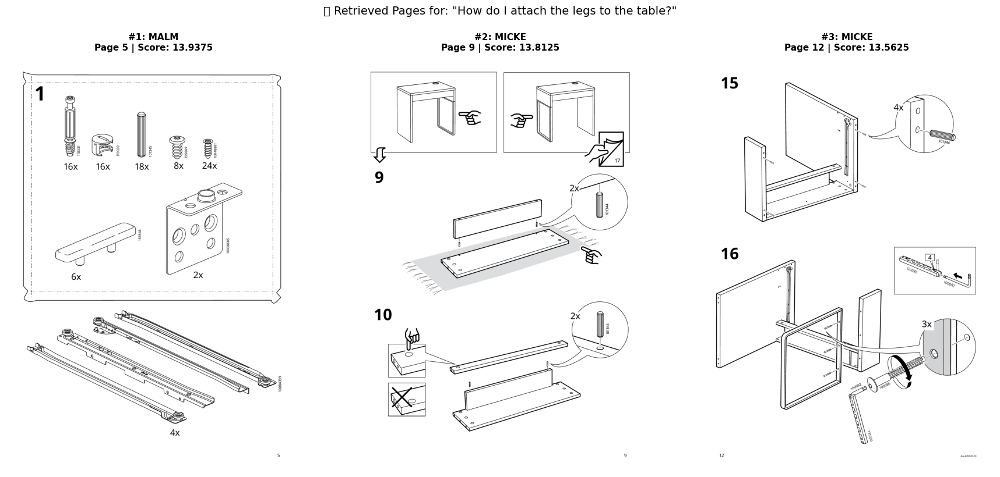


💡 Observation: ColPali retrieved pages that visually show
   leg attachment instructions, even without OCR text extraction!


In [ ]:
# ============================================================================
# CELL 10: 🎨 VISUAL ENHANCEMENT - Display Retrieved Pages with Scores
# ============================================================================

def display_retrieved_pages(results, grouped_images, pdf_files, query):
    """
    Visualize the retrieved document pages with their relevance scores.
    This helps students see what ColPali retrieved for the query.
    """
    n_results = len(grouped_images)
    fig, axes = plt.subplots(1, n_results, figsize=(6 * n_results, 8))

    if n_results == 1:
        axes = [axes]

    for i, (result, img) in enumerate(zip(results, grouped_images)):
        axes[i].imshow(img)

        # Create informative title
        doc_name = pdf_files[result['doc_id']].replace('.pdf', '')
        title = f"#{i+1}: {doc_name}\nPage {result['page_num']} | Score: {result['score']:.4f}"
        axes[i].set_title(title, fontsize=11, fontweight='bold')
        axes[i].axis('off')

    plt.suptitle(f'🔎 Retrieved Pages for: "{query}"', fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

# Display the retrieved pages
display_retrieved_pages(results, grouped_images, pdf_files, text_query)

print("\n💡 Observation: ColPali retrieved pages that visually show")
print("   leg attachment instructions, even without OCR text extraction!")

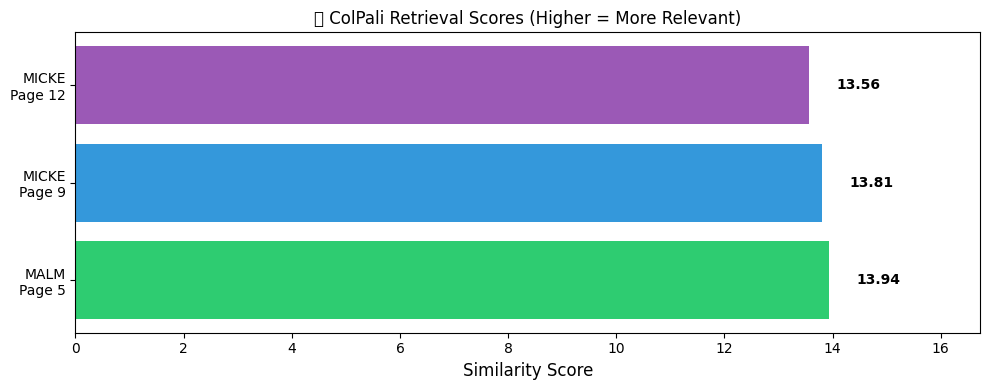

In [ ]:
# ============================================================================
# CELL 11: 🎨 VISUAL ENHANCEMENT - Plot Similarity Scores
# ============================================================================

def plot_similarity_scores(results, pdf_files):
    """
    Visualize the similarity scores as a bar chart.
    Higher scores indicate more relevant documents.
    """
    labels = [f"{pdf_files[r['doc_id']].replace('.pdf', '')}\nPage {r['page_num']}"
              for r in results]
    scores = [r['score'] for r in results]

    fig, ax = plt.subplots(figsize=(10, 4))
    bars = ax.barh(labels, scores, color=['#2ecc71', '#3498db', '#9b59b6'][:len(scores)])

    # Add score labels on bars
    for bar, score in zip(bars, scores):
        ax.text(bar.get_width() + 0.5, bar.get_y() + bar.get_height()/2,
                f'{score:.2f}', va='center', fontsize=10, fontweight='bold')

    ax.set_xlabel('Similarity Score', fontsize=12)
    ax.set_title('📊 ColPali Retrieval Scores (Higher = More Relevant)', fontsize=12)
    ax.set_xlim(0, max(scores) * 1.2)

    plt.tight_layout()
    plt.show()

plot_similarity_scores(results, pdf_files)

---

## 🤖 Initialize Qwen2-VL Vision Language Model

Now we load **Qwen2-VL** — a powerful vision-language model that can:
- Understand images and text together
- Answer questions based on visual content
- Generate natural language responses

As noted in the original tutorial, you can check the [Open VLM Leaderboard](https://huggingface.co/spaces/opencompass/open_vlm_leaderboard) for the latest models.

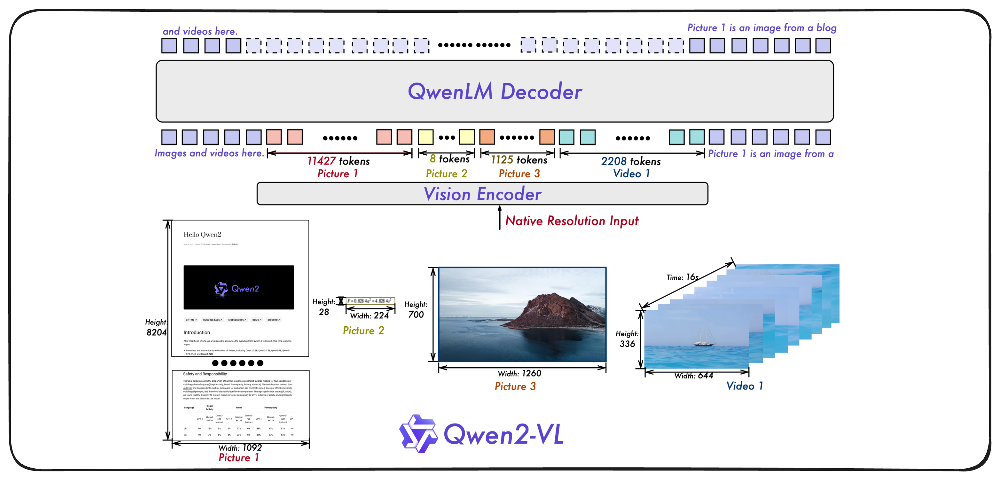

In [ ]:
# ============================================================================
# CELL 12: Load Qwen2-VL Model (from original tutorial)
# ============================================================================

print("🔄 Loading Qwen2-VL-7B-Instruct model...")
print("   (This requires significant GPU memory)\n")

# Load the Vision Language Model
vl_model = Qwen2VLForConditionalGeneration.from_pretrained(
    "Qwen/Qwen2-VL-7B-Instruct",
    torch_dtype=torch.bfloat16,  # Use bfloat16 for memory efficiency
)

# Move to GPU and set to evaluation mode
vl_model.cuda().eval()

print("✅ Qwen2-VL model loaded!")
print(f"   Model: Qwen/Qwen2-VL-7B-Instruct")
print(f"   Dtype: torch.bfloat16")

🔄 Loading Qwen2-VL-7B-Instruct model...
   (This requires significant GPU memory)



config.json: 0.00B [00:00, ?B/s]

model.safetensors.index.json: 0.00B [00:00, ?B/s]

Fetching 5 files:   0%|          | 0/5 [00:00<?, ?it/s]

model-00003-of-00005.safetensors:   0%|          | 0.00/3.86G [00:00<?, ?B/s]

model-00004-of-00005.safetensors:   0%|          | 0.00/3.86G [00:00<?, ?B/s]

model-00001-of-00005.safetensors:   0%|          | 0.00/3.90G [00:00<?, ?B/s]

model-00002-of-00005.safetensors:   0%|          | 0.00/3.86G [00:00<?, ?B/s]

model-00005-of-00005.safetensors:   0%|          | 0.00/1.09G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/5 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/244 [00:00<?, ?B/s]

✅ Qwen2-VL model loaded!
   Model: Qwen/Qwen2-VL-7B-Instruct
   Dtype: torch.bfloat16


In [ ]:
# ============================================================================
# CELL 13: Initialize VLM Processor (from original tutorial)
# ============================================================================

# Configure pixel limits for image processing
# These settings optimize GPU memory usage while maintaining quality
min_pixels = 224 * 224   # Minimum image resolution
max_pixels = 1024 * 1024 # Maximum image resolution

print(f"📐 Image resolution settings:")
print(f"   Min pixels: {min_pixels:,} ({int(min_pixels**0.5)}×{int(min_pixels**0.5)})")
print(f"   Max pixels: {max_pixels:,} ({int(max_pixels**0.5)}×{int(max_pixels**0.5)})")

# Initialize the processor
vl_model_processor = Qwen2VLProcessor.from_pretrained(
    "Qwen/Qwen2-VL-7B-Instruct",
    min_pixels=min_pixels,
    max_pixels=max_pixels
)

print("\n✅ VLM processor initialized!")

📐 Image resolution settings:
   Min pixels: 50,176 (224×224)
   Max pixels: 1,048,576 (1024×1024)


preprocessor_config.json:   0%|          | 0.00/347 [00:00<?, ?B/s]

The image processor of type `Qwen2VLImageProcessor` is now loaded as a fast processor by default, even if the model checkpoint was saved with a slow processor. This is a breaking change and may produce slightly different outputs. To continue using the slow processor, instantiate this class with `use_fast=False`. Note that this behavior will be extended to all models in a future release.


tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

chat_template.json: 0.00B [00:00, ?B/s]


✅ VLM processor initialized!


---

## 💬 Build the Chat Structure for Qwen2-VL

Following the original tutorial, we create a chat template that includes:
1. The **three retrieved images** as context
2. The **user's question**

This allows Qwen2-VL to answer based on the visual content of the relevant document pages.

In [ ]:
# ============================================================================
# CELL 14: Create Chat Template (from original tutorial)
# ============================================================================

# Build the chat structure with retrieved images and query
# This format is required by Qwen2-VL for multimodal input

chat_template = [
    {
        "role": "user",
        "content": [
            # Include all three retrieved images
            {
                "type": "image",
                "image": grouped_images[0],  # First retrieved page
            },
            {
                "type": "image",
                "image": grouped_images[1],  # Second retrieved page
            },
            {
                "type": "image",
                "image": grouped_images[2],  # Third retrieved page
            },
            # Include the user's question
            {
                "type": "text",
                "text": text_query
            },
        ],
    }
]

print("✅ Chat template created!")
print(f"   Images: {len(grouped_images)}")
print(f"   Query: '{text_query}'")

✅ Chat template created!
   Images: 3
   Query: 'How do I attach the legs to the table?'



📤 INPUT TO QWEN2-VL VISION LANGUAGE MODEL


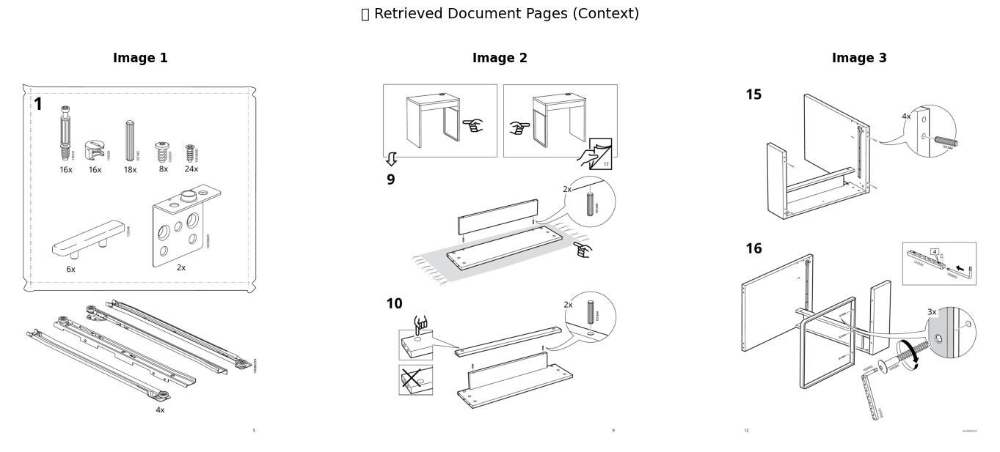


❓ User Query: "How do I attach the legs to the table?"



In [ ]:
# ============================================================================
# CELL 15: 🎨 VISUAL ENHANCEMENT - Show What's Being Sent to the VLM
# ============================================================================

def visualize_vlm_input(grouped_images, query):
    """
    Visualize exactly what we're sending to Qwen2-VL.
    This helps students understand the multimodal RAG pipeline.
    """
    print("\n" + "=" * 70)
    print("📤 INPUT TO QWEN2-VL VISION LANGUAGE MODEL")
    print("=" * 70)

    # Display images
    fig, axes = plt.subplots(1, len(grouped_images), figsize=(5 * len(grouped_images), 6))
    if len(grouped_images) == 1:
        axes = [axes]

    for i, img in enumerate(grouped_images):
        axes[i].imshow(img)
        axes[i].set_title(f"Image {i+1}", fontsize=12, fontweight='bold')
        axes[i].axis('off')

    plt.suptitle("🖼️ Retrieved Document Pages (Context)", fontsize=14, y=1.02)
    plt.tight_layout()
    plt.show()

    # Display query
    print(f"\n❓ User Query: \"{query}\"")
    print("\n" + "=" * 70)

visualize_vlm_input(grouped_images, text_query)

In [ ]:
# ============================================================================
# CELL 16: Apply Chat Template (from original tutorial)
# ============================================================================

# Apply the chat template to format the input
text = vl_model_processor.apply_chat_template(
    chat_template,
    tokenize=False,              # Don't tokenize yet
    add_generation_prompt=True   # Add prompt for generation
)

print("✅ Chat template applied!")
print(f"\n📝 Formatted prompt (first 500 chars):")
print("-" * 50)
print(text[:500] + "...")

✅ Chat template applied!

📝 Formatted prompt (first 500 chars):
--------------------------------------------------
<|im_start|>system
You are a helpful assistant.<|im_end|>
<|im_start|>user
<|vision_start|><|image_pad|><|vision_end|><|vision_start|><|image_pad|><|vision_end|><|vision_start|><|image_pad|><|vision_end|>How do I attach the legs to the table?<|im_end|>
<|im_start|>assistant
...


In [ ]:
# ============================================================================
# CELL 17: Process Inputs for VLM (from original tutorial)
# ============================================================================

# Process the vision information (images)
image_inputs, video_inputs = process_vision_info(chat_template)

# Prepare inputs for the model
inputs = vl_model_processor(
    text=[text], #User question
    images=image_inputs, #Retreived images from ikea manual
    videos=video_inputs,
    padding=True,
    return_tensors="pt",
)

# Move inputs to GPU
inputs = inputs.to("cuda")

print("✅ Inputs processed and moved to GPU!")
print(f"\n📊 Input tensor shapes:")
for key, value in inputs.items():
    if hasattr(value, 'shape'):
        print(f"   {key}: {value.shape}")

✅ Inputs processed and moved to GPU!

📊 Input tensor shapes:
   input_ids: torch.Size([1, 3905])
   attention_mask: torch.Size([1, 3905])
   pixel_values: torch.Size([15480, 1176])
   image_grid_thw: torch.Size([3, 3])


---

## 🎯 Generate Answer with Qwen2-VL

Now we run the complete **multimodal RAG pipeline**:
1. ✅ Query indexed with ColPali
2. ✅ Relevant pages retrieved
3. ✅ Images + query formatted for Qwen2-VL
4. 🔜 **Generate answer based on visual content**

In [ ]:
# ============================================================================
# CELL 18: Generate Answer (from original tutorial)
# ============================================================================

print("🤖 Generating answer with Qwen2-VL...\n")

# Generate response
generated_ids = vl_model.generate(
    **inputs,
    max_new_tokens=500  # Maximum length of generated response
)

# Extract only the generated tokens (remove input tokens)
generated_ids_trimmed = [
    out_ids[len(in_ids):]
    for in_ids, out_ids in zip(inputs.input_ids, generated_ids)
]

# Decode the generated tokens to text
output_text = vl_model_processor.batch_decode(
    generated_ids_trimmed,
    skip_special_tokens=True,
    clean_up_tokenization_spaces=False
)

print("✅ Answer generated!")

🤖 Generating answer with Qwen2-VL...

✅ Answer generated!



🎯 MULTIMODAL RAG RESULT

❓ QUERY: How do I attach the legs to the table?

📚 RETRIEVED SOURCES:
   1. MALM (Page 5) - Score: 13.9375
   2. MICKE (Page 9) - Score: 13.8125
   3. MICKE (Page 12) - Score: 13.5625

💬 GENERATED ANSWER:
----------------------------------------------------------------------
To attach the legs to the table, follow these steps:

1. **Prepare the Table**: Ensure the table is flat and stable on a secure surface.

2. **Attach the Legs**:
   - Locate the legs and the screws provided in the instructions.
   - Place the legs on the table where they are designated to be attached.
   - Insert the screws into the holes on the legs.
   - Secure the legs to the table by tightening the screws.

3. **Ensure Stability**: Make sure the legs are firmly attached and the table is stable.

4. **Final Check**: Double-check that all screws are tightened securely and the table is stable.

By following these steps, you should be able to attach the legs to the table successfully.
----

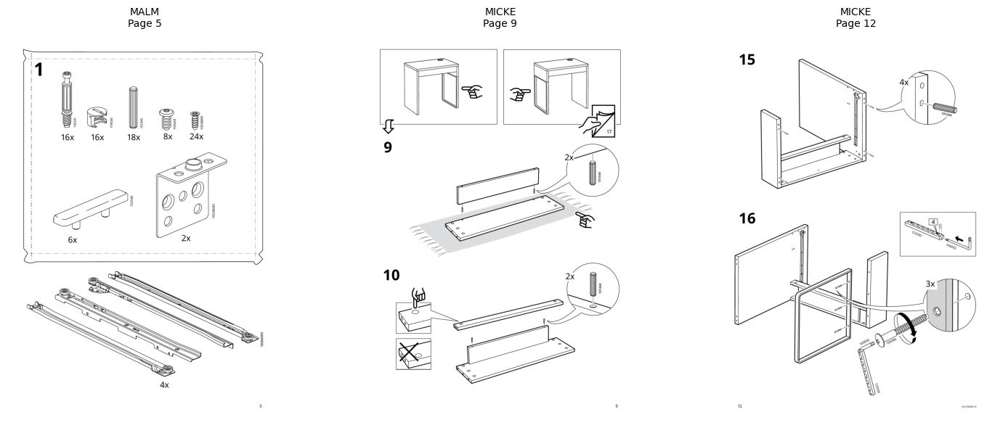

In [ ]:
# ============================================================================
# CELL 19: 🎨 VISUAL ENHANCEMENT - Display Final Result
# ============================================================================

def display_rag_result(query, grouped_images, answer, results, pdf_files):
    """
    Display the complete RAG result with context and answer.
    """
    print("\n" + "=" * 70)
    print("🎯 MULTIMODAL RAG RESULT")
    print("=" * 70)

    # Show the query
    print(f"\n❓ QUERY: {query}")

    # Show retrieved sources
    print(f"\n📚 RETRIEVED SOURCES:")
    for i, result in enumerate(results):
        doc_name = pdf_files[result['doc_id']].replace('.pdf', '')
        print(f"   {i+1}. {doc_name} (Page {result['page_num']}) - Score: {result['score']:.4f}")

    # Display the answer prominently
    print(f"\n💬 GENERATED ANSWER:")
    print("-" * 70)
    print(answer[0] if isinstance(answer, list) else answer)
    print("-" * 70)

    # Show the retrieved images below
    print("\n🖼️ Retrieved Document Pages (used as context):")
    fig, axes = plt.subplots(1, len(grouped_images), figsize=(5 * len(grouped_images), 6))
    if len(grouped_images) == 1:
        axes = [axes]

    for i, (img, result) in enumerate(zip(grouped_images, results)):
        axes[i].imshow(img)
        doc_name = pdf_files[result['doc_id']].replace('.pdf', '')
        axes[i].set_title(f"{doc_name}\nPage {result['page_num']}", fontsize=10)
        axes[i].axis('off')

    plt.tight_layout()
    plt.show()

# Display the complete result
display_rag_result(text_query, grouped_images, output_text, results, pdf_files)

---

## 🔄  Complete RAG Pipeline Function

Let's wrap everything into a reusable function for testing different queries.

In [ ]:
# ============================================================================
# CELL 20: Complete RAG Pipeline Function
# ============================================================================

def answer_with_multimodal_rag(
    vl_model,
    docs_retrieval_model,
    vl_model_processor,
    all_images,
    pdf_files,
    text_query,
    top_k=3,
    max_new_tokens=500,
    show_visuals=True
):
    """
    Complete multimodal RAG pipeline.

    Args:
        vl_model: Qwen2-VL model
        docs_retrieval_model: ColPali retrieval model
        vl_model_processor: VLM processor
        all_images: All document page images
        pdf_files: List of PDF filenames
        text_query: User's question
        top_k: Number of pages to retrieve
        max_new_tokens: Max length of generated answer
        show_visuals: Whether to display visual outputs

    Returns:
        Generated answer text
    """
    # Step 1: Retrieve relevant documents
    results = docs_retrieval_model.search(text_query, k=top_k)
    grouped_images = get_grouped_images(results, all_images)

    # Step 2: Build chat template
    chat_template = [
        {
            "role": "user",
            "content": [
                {"type": "image", "image": img} for img in grouped_images
            ] + [{"type": "text", "text": text_query}]
        }
    ]

    # Step 3: Process inputs
    text = vl_model_processor.apply_chat_template(
        chat_template, tokenize=False, add_generation_prompt=True
    )
    image_inputs, video_inputs = process_vision_info(chat_template)
    inputs = vl_model_processor(
        text=[text], images=image_inputs, videos=video_inputs,
        padding=True, return_tensors="pt"
    ).to("cuda")

    # Step 4: Generate answer
    generated_ids = vl_model.generate(**inputs, max_new_tokens=max_new_tokens)
    generated_ids_trimmed = [
        out_ids[len(in_ids):]
        for in_ids, out_ids in zip(inputs.input_ids, generated_ids)
    ]
    output_text = vl_model_processor.batch_decode(
        generated_ids_trimmed, skip_special_tokens=True,
        clean_up_tokenization_spaces=False
    )

    # Step 5: Display results
    if show_visuals:
        display_rag_result(text_query, grouped_images, output_text, results, pdf_files)

    return output_text[0]

print("✅ RAG pipeline function defined!")

✅ RAG pipeline function defined!


---

## 🧪 Test with Additional Queries

Let's test our multimodal RAG system with different types of questions about IKEA furniture assembly.


🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 🔍 

🎯 MULTIMODAL RAG RESULT

❓ QUERY: What tools do I need to assemble the BILLY bookcase?

📚 RETRIEVED SOURCES:
   1. BILLY (Page 1) - Score: 14.4375
   2. MICKE (Page 20) - Score: 11.6875
   3. MALM (Page 18) - Score: 11.5625

💬 GENERATED ANSWER:
----------------------------------------------------------------------
To assemble the BILLY bookcase, you will need a screwdriver, a drill, and a hammer.
----------------------------------------------------------------------

🖼️ Retrieved Document Pages (used as context):


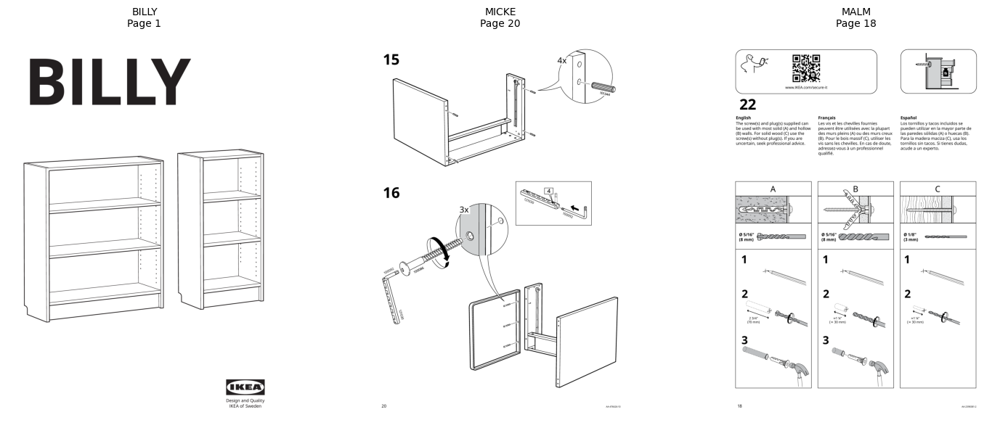

In [ ]:
query1 = "What tools do I need to assemble the BILLY bookcase?"

print("\n" + "🔍 " * 20)
answer1 = answer_with_multimodal_rag(
    vl_model=vl_model,
    docs_retrieval_model=docs_retrieval_model,
    vl_model_processor=vl_model_processor,
    all_images=all_images,
    pdf_files=pdf_files,
    text_query=query1,
    top_k=3
)

### Key Components

| Component | Model | Purpose |
|-----------|-------|--------|
| Document Retrieval | ColPali (vidore/colpali-v1.2) | Embed and search document pages as images |
| Answer Generation | Qwen2-VL-7B-Instruct | Visual question answering on retrieved pages |

### Advantages of This Approach

✅ **No OCR needed** — treats documents as images directly  
✅ **Handles visual content** — diagrams, tables, layouts  
✅ **Semantic search** — understands meaning, not just keywords  
✅ **End-to-end trainable** — can be fine-tuned for specific domains